<a href="https://colab.research.google.com/github/diegulio/Breed_Recognition-to-Buscomiperro/blob/main/BMP_ModelV3.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
!pip install wandb -qqq

     |████████████████████████████████| 1.8MB 7.5MB/s 
     |████████████████████████████████| 102kB 13.3MB/s 
     |████████████████████████████████| 174kB 48.2MB/s 
     |████████████████████████████████| 133kB 40.7MB/s 
     |████████████████████████████████| 71kB 10.5MB/s 


In [ ]:
import tensorflow as tf
from tensorflow.keras.utils import plot_model
from tensorflow.keras.models import load_model
from tensorflow import keras
# import wandb
# from wandb.keras import WandbCallback
import matplotlib.pyplot as plt


In [ ]:
# Log in to your W&B account
wandb.login()

<IPython.core.display.Javascript object>

wandb: Appending key for api.wandb.ai to your netrc file: /root/.netrc


True

# Helper Functions

In [ ]:
# Plot the validation and training data separately
def plot_loss_curves(history):
  """
  Returns separate loss curves for training and validation metrics.
  """ 
  loss = history.history['loss']
  val_loss = history.history['val_loss']

  accuracy = history.history['accuracy']
  val_accuracy = history.history['val_accuracy']

  epochs = range(len(history.history['loss']))

  # Plot loss
  plt.plot(epochs, loss, label='training_loss')
  plt.plot(epochs, val_loss, label='val_loss')
  plt.title('Loss')
  plt.xlabel('Epochs')
  plt.legend()

  # Plot accuracy
  plt.figure()
  plt.plot(epochs, accuracy, label='training_accuracy')
  plt.plot(epochs, val_accuracy, label='val_accuracy')
  plt.title('Accuracy')
  plt.xlabel('Epochs')
  plt.legend();
  


# Convierte una carpeta en formato zip, esto para que pueda ser descargada en google colab
def zip_folder(folder_dir):
  import shutil
  shutil.make_archive(folder_dir, 'zip', folder_dir)


# Crea el modelo con API funcional
def create_model_application(model_application, preprocess_input, img_size, model_name = 'Model'):
  from tensorflow.keras.utils import plot_model

  base_model = model_application(include_top = False)
  base_model.trainable = False

  plot_model(base_model, to_file = model_name + '_plot.png')

  # Arquitectura

  inputs = tf.keras.layers.Input(img_size + (3,), name = 'Input_Layer')

  x = preprocess_input(inputs)

  x = base_model(x, training = False) # se me olvido poner trainable = False D: no me la container amarillo

  x = tf.keras.layers.GlobalAveragePooling2D(name = 'global_average_layer')(x)

  outputs = tf.keras.layers.Dense(NUM_CLASSES, activation='softmax', name = 'Output_Layer')(x)

  model = tf.keras.Model(inputs, outputs, name = model_name)

  model.compile(loss='categorical_crossentropy',
              optimizer=tf.keras.optimizers.Adam(),
              metrics=["accuracy"])

  return model



# Callbacks

In [ ]:
import datetime
import os

def create_tensorboard_callback(dir_name, experiment_name):
  # Si no esta el directorio dir_name creado, lo creamos
  if dir_name not in os.listdir():
    os.mkdir(dir_name)

  log_dir = dir_name + "/" + experiment_name + "/" + datetime.datetime.now().strftime("%Y%m%d-%H%M%S")
  tensorboard_callback = tf.keras.callbacks.TensorBoard(
      log_dir=log_dir
  )
  print(f"Saving TensorBoard log files to: {log_dir}")
  return tensorboard_callback


reduceLR_callback = tf.keras.callbacks.ReduceLROnPlateau(
    monitor='val_loss', factor=0.1, patience=2, verbose=1
)

# Directories

In [ ]:
train_dir = '/content/drive/MyDrive/Colab Data/Proyecto buscomiperro/train_v3'
test_dir = '/content/drive/MyDrive/Colab Data/Proyecto buscomiperro/test_v3'


# Data



In [ ]:
train_data = tf.keras.preprocessing.image_dataset_from_directory(train_dir,
                                                                 label_mode='categorical',
                                                                 image_size = (600,600),
                                                                 batch_size = 32
                                                                 )
  
test_data = tf.keras.preprocessing.image_dataset_from_directory(test_dir,
                                                                label_mode = 'categorical',
                                                                image_size = (600,600),
                                                                batch_size = 32
                                                                )

Found 8177 files belonging to 113 classes.
Found 1997 files belonging to 113 classes.


In [ ]:
class_names = train_data.class_names
class_indices = dict(enumerate(class_names))
class_indices = dict([(value, key) for key, value in class_indices.items()])
class_indices


In [ ]:
# Guardo el diccionario de clases para cuando tenga que predecir
#import pickle as pkl
#a_file = open("class_indices-v3.pkl", "wb")
#pkl.dump(class_indices, a_file)
#a_file.close()

Ahora tenemos 113 clases

In [ ]:
NUM_CLASSES = 113

# EfficientNet-7

In [ ]:
wandb.init(
    project = "buscomiperro",
    config = {
        'img_size' : (600,600),
        'batch_size' : 32,
        'num_classes' : NUM_CLASSES,
        'activation': 'softmax',
        'model_name' : 'efficientNet7V3',
        'loss' : 'categorical_crossentropy',
        'optimizer' : 'adam',
        'metrics' : ['accuracy'],
        'epochs' : 5,
        'steps_per_epoch' : len(train_data),
        'train_data' : train_data,
        'val_data' : test_data,
        'val_steps' : len(test_data)
    },
    tags = ['modelv3'],
    name = 'modelv3'
)

wandb: Currently logged in as: diegulio (use `wandb login --relogin` to force relogin)


In [ ]:
from tensorflow.keras.applications import EfficientNetB7
from tensorflow.keras.applications.efficientnet import preprocess_input

config = wandb.config

base_model = EfficientNetB7(include_top = False)
base_model.trainable = False

plot_model(base_model, to_file = config.model_name + '_plot.png')

# Arquitectura

inputs = tf.keras.layers.Input(tuple(config.img_size) + (3,), name = 'Input_Layer')

x = preprocess_input(inputs)

x = base_model(x, training = False) 

x = tf.keras.layers.GlobalAveragePooling2D(name = 'global_average_layer')(x)

outputs = tf.keras.layers.Dense(config.num_classes, activation=config.activation, name = 'Output_Layer')(x)

model_v3 = tf.keras.Model(inputs, outputs, name = config.model_name)

model_v3.compile(loss=config.loss,
            optimizer=config.optimizer,
            metrics=config.metrics)

258080768/258076736 [==============================] - 2s 0us/step
dot: graph is too large for cairo-renderer bitmaps. Scaling by 0.414274 to fit



In [ ]:
# Fit 
history = model_v3.fit(train_data,
                    epochs=config.epochs,
                    steps_per_epoch=config.steps_per_epoch,
                    validation_data=test_data,
                    validation_steps=config.val_steps,
                    # Add Wandb callback
                    callbacks=[WandbCallback()]) # name of log files

Epoch 1/5
256/256 [==============================] - 2653s 10s/step - loss: 1.0280 - accuracy: 0.8789 - val_loss: 0.1671 - val_accuracy: 0.9755


/usr/local/lib/python3.7/dist-packages/tensorflow/python/keras/utils/generic_utils.py:497: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  category=CustomMaskWarning)


Epoch 2/5
256/256 [==============================] - 870s 3s/step - loss: 0.1346 - accuracy: 0.9752 - val_loss: 0.1085 - val_accuracy: 0.9765
Epoch 3/5
256/256 [==============================] - 869s 3s/step - loss: 0.0872 - accuracy: 0.9826 - val_loss: 0.0932 - val_accuracy: 0.9770
Epoch 4/5
256/256 [==============================] - 869s 3s/step - loss: 0.0636 - accuracy: 0.9870 - val_loss: 0.0855 - val_accuracy: 0.9790
Epoch 5/5
256/256 [==============================] - 869s 3s/step - loss: 0.0481 - accuracy: 0.9897 - val_loss: 0.0819 - val_accuracy: 0.9780


In [ ]:
wandb.finish()
model_v3.evaluate(test_data)

epoch,4
loss,0.04807
accuracy,0.98973
val_loss,0.0819
val_accuracy,0.97797
_runtime,6329
_timestamp,1624733226
_step,4
best_val_loss,0.0819
best_epoch,4


epoch,▁▃▅▆█
loss,█▂▁▁▁
accuracy,▁▇███
val_loss,█▃▂▁▁
val_accuracy,▁▃▄█▆
_runtime,▁▃▅▆█
_timestamp,▁▃▅▆█
_step,▁▃▅▆█


63/63 [==============================] - 171s 3s/step - loss: 0.0819 - accuracy: 0.9780


[0.08190437406301498, 0.9779669642448425]

In [ ]:
model_v3.save('model_v3.h5')

/usr/local/lib/python3.7/dist-packages/tensorflow/python/keras/utils/generic_utils.py:497: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  category=CustomMaskWarning)


# Finetune

In [ ]:
model_v3.summary()

Model: "efficientNet7V3"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
Input_Layer (InputLayer)     [(None, 600, 600, 3)]     0         
_________________________________________________________________
efficientnetb7 (Functional)  (None, None, None, 2560)  64097687  
_________________________________________________________________
global_average_layer (Global (None, 2560)              0         
_________________________________________________________________
Output_Layer (Dense)         (None, 113)               289393    
Total params: 64,387,080
Trainable params: 289,393
Non-trainable params: 64,097,687
_________________________________________________________________


In [ ]:
BASE_LAYER = 1 # La capa 1 tiene el modelo base

In [ ]:
def count_non_trainable_layers(model):
  layers_non_trainable = 0
  for layer in model.layers[1].layers:
    if layer.trainable == False:
      layers_non_trainable += 1

  print(f'% non trainable layers {layers_non_trainable/len(model.layers[1].layers)*100}%')

In [ ]:
count_non_trainable_layers(model_v3)

% non trainable layers 100.0%


In [ ]:
# Descongelamos un 15%
num_trainable_layers = int(len(model_v3.layers[1].layers)*0.15)
num_trainable_layers

121

In [ ]:
# Descongelamos un 15%
for layer in model_v3.layers[BASE_LAYER].layers[-num_trainable_layers:]:
  layer.trainable = True

In [ ]:
count_non_trainable_layers(model_v3)

% non trainable layers 85.11685116851169%


In [ ]:
from tensorflow.keras.optimizers import Adam
wandb.init(
    project = "buscomiperro",
    config = {
        'img_size' : (600,600),
        'batch_size' : 32,
        'num_classes' : NUM_CLASSES,
        'activation': 'softmax',
        'model_name' : 'efficientNet7_FineTuneV3',
        'loss' : 'categorical_crossentropy',
        'optimizer' : 'adam', # Disminuyo la tasa de aprendizaje
        'metrics' : ['accuracy'],
        'epochs' : 10,
        'steps_per_epoch' : len(train_data),
        'train_data' : train_data,
        'val_data' : test_data,
        'val_steps' : len(test_data)
    },
    tags = ['fine-tune-v3'],
    name = 'fine-tune-v3_15%layers'
)

In [ ]:
config = wandb.config
model_v3.compile(loss=config.loss,
            optimizer=config.optimizer,
            metrics=config.metrics)

In [ ]:
# Disminuyo learning rate

from keras import backend as K

K.set_value(model_v3.optimizer.lr, 0.0001/10)

print(f'new learning rate : {K.get_value(model_v3.optimizer.lr)}')

new learning rate : 9.999999747378752e-06


In [ ]:
# Fit 
history_fine = model_v3.fit(train_data,
                    epochs=config.epochs,
                    initial_epoch = history.epoch[-1], # comienzo desde la última epoch pre fine tune
                    steps_per_epoch=config.steps_per_epoch,
                    validation_data=test_data,
                    validation_steps=config.val_steps,
            
                    # Add Wandb callback
                    callbacks=[reduceLR_callback, WandbCallback()]) # name of log files

Epoch 5/10
256/256 [==============================] - 891s 3s/step - loss: 0.0349 - accuracy: 0.9932 - val_loss: 0.0802 - val_accuracy: 0.9795


/usr/local/lib/python3.7/dist-packages/tensorflow/python/keras/utils/generic_utils.py:497: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  category=CustomMaskWarning)


Epoch 6/10
256/256 [==============================] - 870s 3s/step - loss: 0.0339 - accuracy: 0.9934 - val_loss: 0.0790 - val_accuracy: 0.9795
Epoch 7/10
256/256 [==============================] - 870s 3s/step - loss: 0.0331 - accuracy: 0.9938 - val_loss: 0.0781 - val_accuracy: 0.9805
Epoch 8/10
256/256 [==============================] - 870s 3s/step - loss: 0.0324 - accuracy: 0.9940 - val_loss: 0.0774 - val_accuracy: 0.9805
Epoch 9/10
256/256 [==============================] - 871s 3s/step - loss: 0.0318 - accuracy: 0.9939 - val_loss: 0.0769 - val_accuracy: 0.9810
Epoch 10/10
256/256 [==============================] - 870s 3s/step - loss: 0.0313 - accuracy: 0.9941 - val_loss: 0.0764 - val_accuracy: 0.9805


## Graficamos el proceso

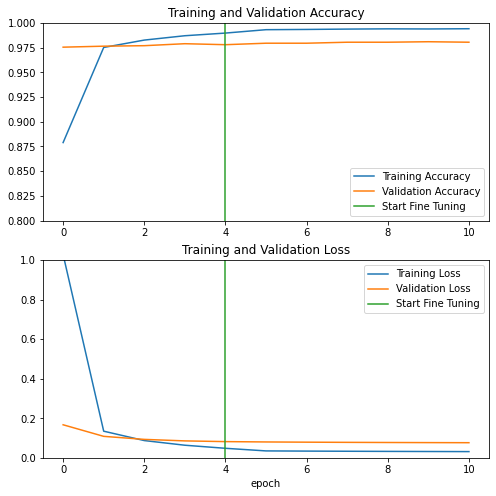

In [ ]:
initial_epochs = 5
fine_tune_epochs = 5
total_epochs =  initial_epochs + fine_tune_epochs

# Juntamos los historiales para graficar 
acc = history.history['accuracy'] + history_fine.history['accuracy']
val_acc = history.history['val_accuracy'] + history_fine.history['val_accuracy']

loss = history.history['loss'] + history_fine.history['loss']
val_loss = history.history['val_loss'] + history_fine.history['val_loss']


plt.figure(figsize=(8, 8))
plt.subplot(2, 1, 1)
plt.plot(acc, label='Training Accuracy')
plt.plot(val_acc, label='Validation Accuracy')
plt.ylim([0.8, 1])
plt.plot([initial_epochs-1,initial_epochs-1],
          plt.ylim(), label='Start Fine Tuning')
plt.legend(loc='lower right')
plt.title('Training and Validation Accuracy')

plt.subplot(2, 1, 2)
plt.plot(loss, label='Training Loss')
plt.plot(val_loss, label='Validation Loss')
plt.ylim([0, 1.0])
plt.plot([initial_epochs-1,initial_epochs-1],
         plt.ylim(), label='Start Fine Tuning')
plt.legend(loc='upper right')
plt.title('Training and Validation Loss')
plt.xlabel('epoch')
plt.show()

In [ ]:
model_v3.evaluate(test_data)
wandb.finish()

63/63 [==============================] - 171s 3s/step - loss: 0.0764 - accuracy: 0.9805


epoch,9
loss,0.03132
accuracy,0.99413
val_loss,0.07638
val_accuracy,0.98047
lr,1e-05
_runtime,5414
_timestamp,1624742194
_step,5
best_val_loss,0.07638
best_epoch,9


epoch,▁▂▄▅▇█
loss,█▆▄▃▂▁
accuracy,▁▃▅▇▆█
val_loss,█▆▄▃▂▁
val_accuracy,▁▁▆▆█▆
lr,▁▁▁▁▁▁
_runtime,▁▂▄▅▇█
_timestamp,▁▂▄▅▇█
_step,▁▂▄▅▇█


In [ ]:
model_v3.save('model_v3-Finetune.h5')

/usr/local/lib/python3.7/dist-packages/tensorflow/python/keras/utils/generic_utils.py:497: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  category=CustomMaskWarning)


# Plot Wrong Predictions

In [ ]:
def plot_wrong_predictions(model, target_dir, target_class , class_names = test_data.class_names):
  import os
  import random
  from keras.preprocessing.image import load_img
  from keras.preprocessing.image import img_to_array
  import matplotlib.pyplot as plt
  import numpy as np

  
  

  img = load_img(target_dir, target_size = (600,600))
  img_array = tf.expand_dims(img_to_array(img), axis = 0)

  
  predictions_array = model.predict(img_array)[0]

  predicted_idx = np.argmax(predictions_array)
  predicted_label = class_names[predicted_idx]

  if predicted_label != target_class:
    fig = plt.figure(figsize = (30, 5))

    fig.add_subplot(1,2,1)
    plt.grid(False)
    plt.xticks([])
    plt.yticks([])

    plt.imshow(img, cmap=plt.cm.binary)

    
    
    if predicted_label == target_class:
      color = 'blue'
    else:
      color = 'red'

    plt.xlabel("{} {:2.0f}% ({})".format(class_names[predicted_idx],
                                  100*np.max(predictions_array),
                                  class_names[class_names.index(target_class)]),
                                  color=color)
    
    
    best_10 = predictions_array.argsort()[-10:][::-1]
    best_10_labels = []
    for idx in best_10:
      best_10_labels.append(class_names[idx])
    
    fig.add_subplot(1,2,2)
    plt.xticks(range(10), best_10_labels, rotation = 20)
    #plt.yticks([])
    thisplot = plt.bar(range(10), predictions_array[best_10], color="#777777")
    plt.ylim([0, 1])
    predicted_label = np.argmax(best_10)

    thisplot[0].set_color('red')
    #thisplot[target_class].set_color('blue')
    plt.show()
    return target_class

In [ ]:
model = load_model('/content/model_v3-Finetune.h5')

In [ ]:
model.evaluate(test_data)

63/63 [==============================] - 176s 3s/step - loss: 0.0764 - accuracy: 0.9805


[0.07638030499219894, 0.9804707169532776]

## Test

Analizando Raza :  boston_bull
0.8849557522123894%


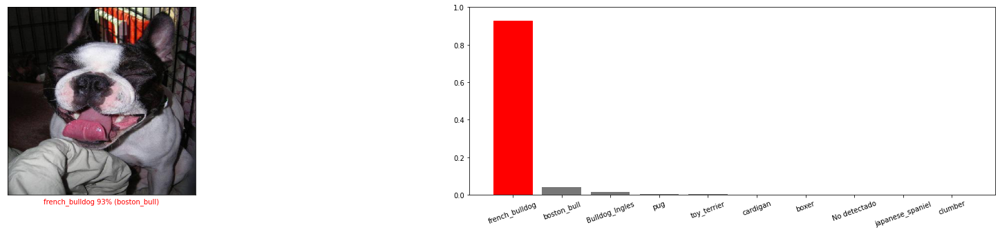

Analizando Raza :  rottweiler
1.7699115044247788%


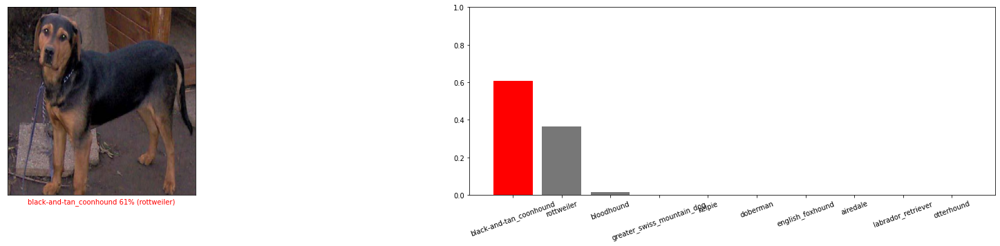

Analizando Raza :  whippet
2.6548672566371683%


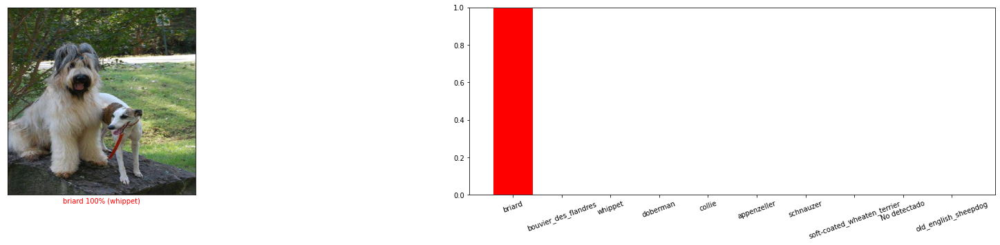

Analizando Raza :  great_pyrenees
3.5398230088495577%
Analizando Raza :  irish_setter
4.424778761061947%
Analizando Raza :  australian_terrier
5.3097345132743365%


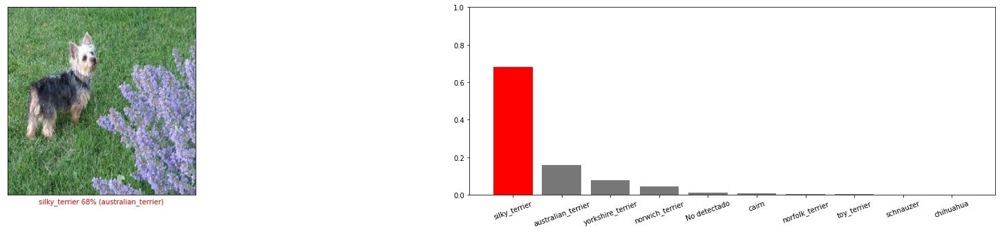

Analizando Raza :  norwich_terrier
6.1946902654867255%
Analizando Raza :  maltese_dog
7.079646017699115%


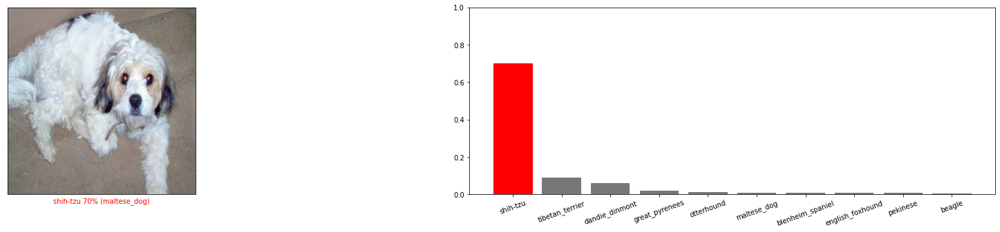

Analizando Raza :  kelpie
7.964601769911504%


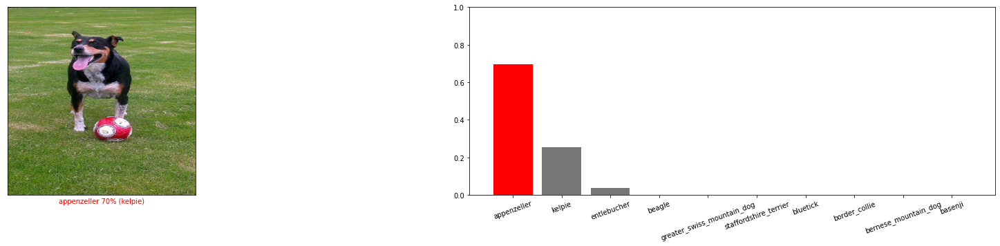

Analizando Raza :  Bulldog_Ingles
8.849557522123893%
Analizando Raza :  schnauzer
9.734513274336283%
Analizando Raza :  schipperke
10.619469026548673%


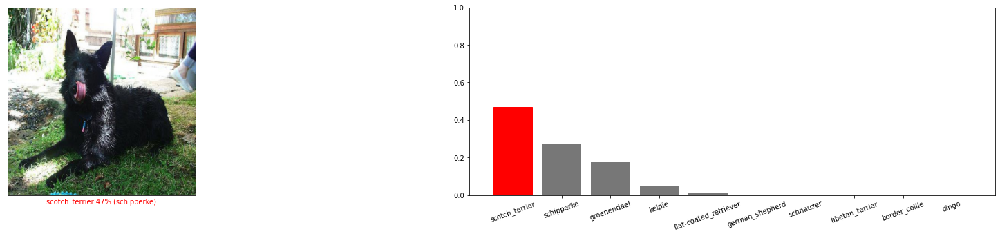

Analizando Raza :  pekinese
11.504424778761061%
Analizando Raza :  Dalmata
12.389380530973451%
Analizando Raza :  leonberg
13.274336283185843%
Analizando Raza :  No detectado
14.15929203539823%
Analizando Raza :  pomeranian
15.04424778761062%
Analizando Raza :  irish_wolfhound
15.929203539823009%
Analizando Raza :  basenji
16.8141592920354%
Analizando Raza :  blenheim_spaniel
17.699115044247787%


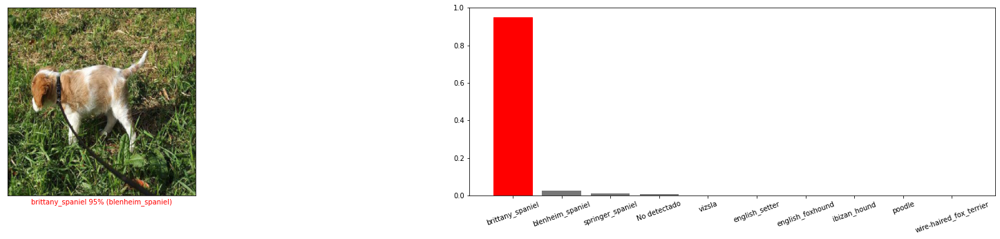

Analizando Raza :  gato
18.58407079646018%
Analizando Raza :  basset
19.469026548672566%
Analizando Raza :  yorkshire_terrier
20.353982300884958%


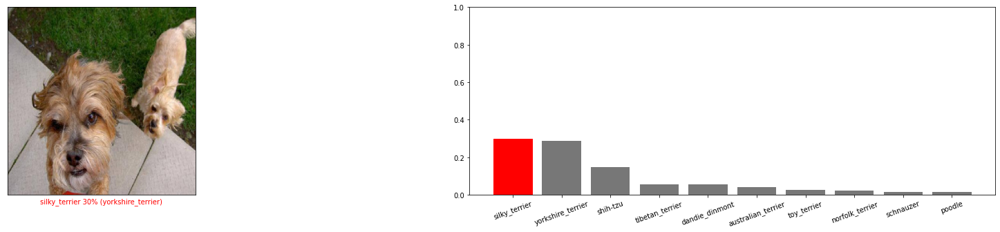

Analizando Raza :  saint_bernard
21.238938053097346%
Analizando Raza :  dhole
22.123893805309734%
Analizando Raza :  japanese_spaniel
23.008849557522122%
Analizando Raza :  komondor
23.893805309734514%


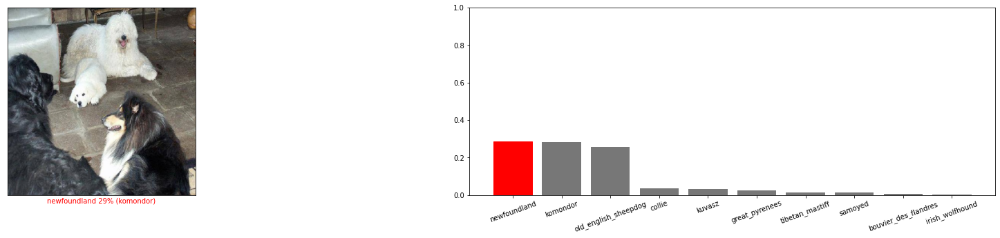

Analizando Raza :  african_hunting_dog
24.778761061946902%
Analizando Raza :  kerry_blue_terrier
25.663716814159294%
Analizando Raza :  miniature_pinscher
26.548672566371685%
Analizando Raza :  collie
27.43362831858407%
Analizando Raza :  vizsla
28.31858407079646%


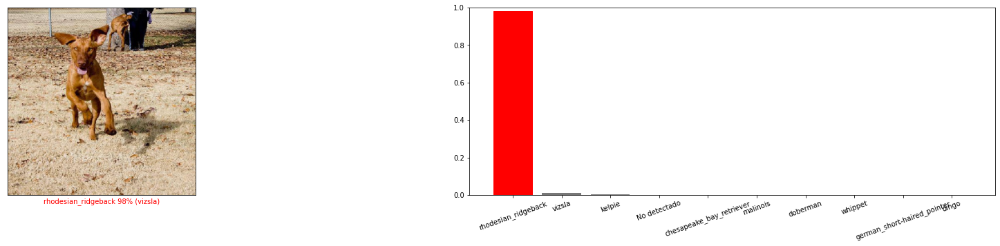

Analizando Raza :  scottish_deerhound
29.20353982300885%
Analizando Raza :  cairn
30.08849557522124%
Analizando Raza :  black-and-tan_coonhound
30.973451327433626%
Analizando Raza :  chihuahua
31.858407079646017%


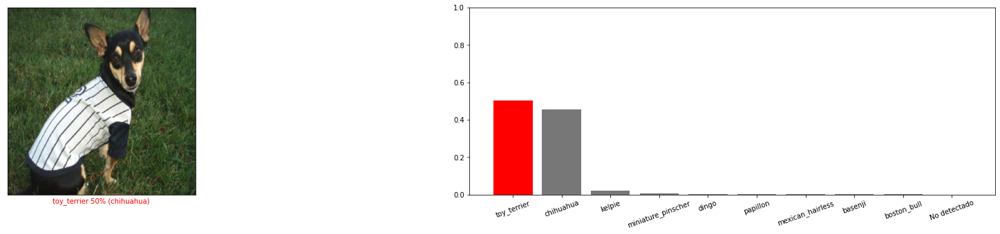

Analizando Raza :  newfoundland
32.743362831858406%
Analizando Raza :  beagle
33.6283185840708%


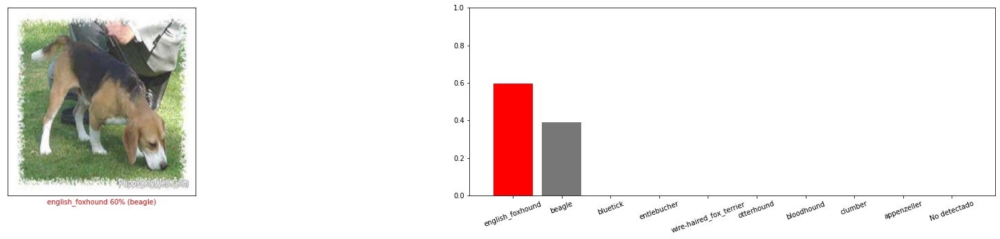

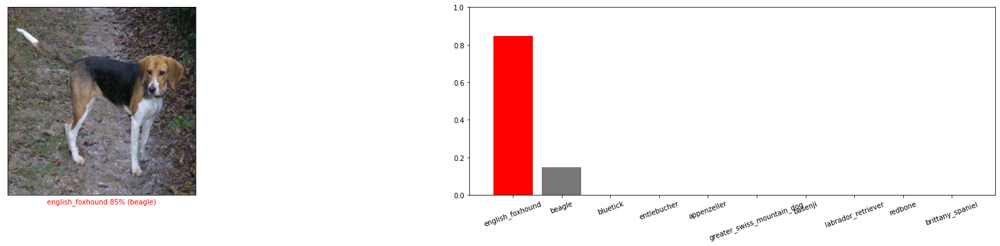

Analizando Raza :  afghan_hound
34.51327433628318%
Analizando Raza :  pug
35.39823008849557%
Analizando Raza :  silky_terrier
36.283185840707965%


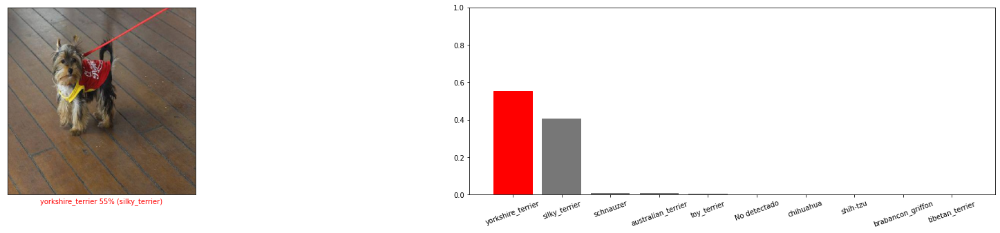

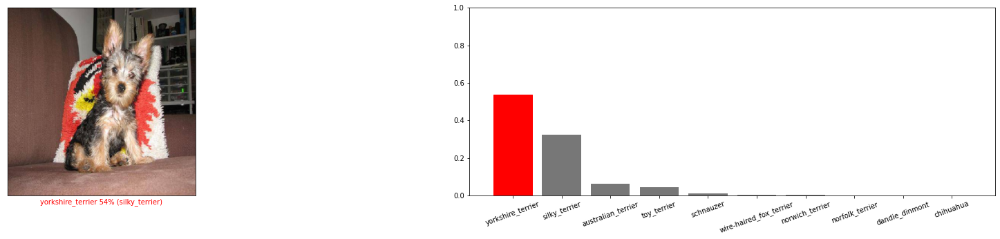

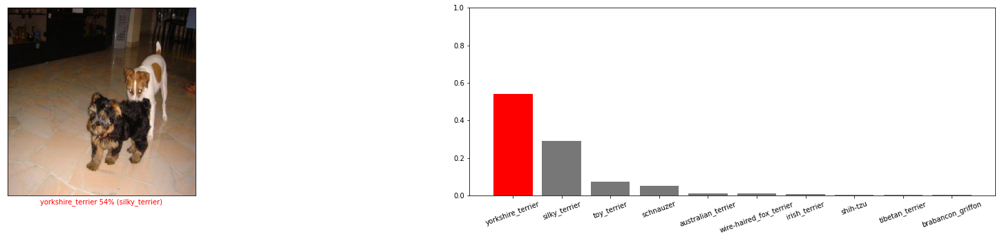

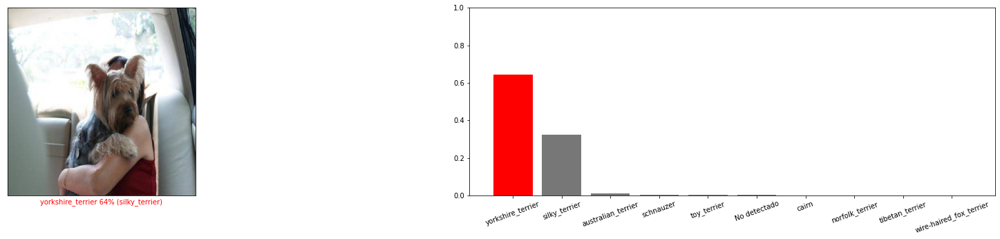

Analizando Raza :  doberman
37.16814159292036%
Analizando Raza :  papillon
38.05309734513274%
Analizando Raza :  norwegian_elkhound
38.93805309734513%


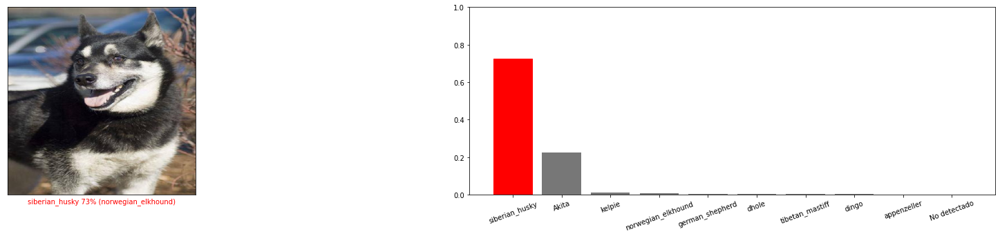

Analizando Raza :  brittany_spaniel
39.823008849557525%
Analizando Raza :  affenpinscher
40.707964601769916%
Analizando Raza :  weimaraner
41.5929203539823%
Analizando Raza :  west_highland_white_terrier
42.47787610619469%


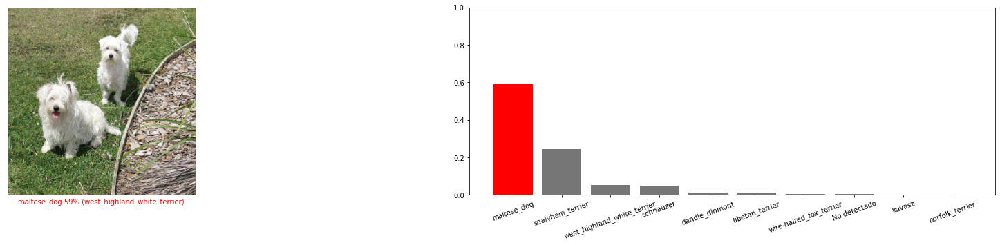

Analizando Raza :  italian_greyhound
43.36283185840708%
Analizando Raza :  pembroke
44.24778761061947%
Analizando Raza :  cocker_spaniel
45.13274336283185%
Analizando Raza :  brabancon_griffon
46.017699115044245%
Analizando Raza :  rhodesian_ridgeback
46.902654867256636%
Analizando Raza :  ibizan_hound
47.78761061946903%
Analizando Raza :  shih-tzu
48.67256637168141%
Analizando Raza :  flat-coated_retriever
49.557522123893804%


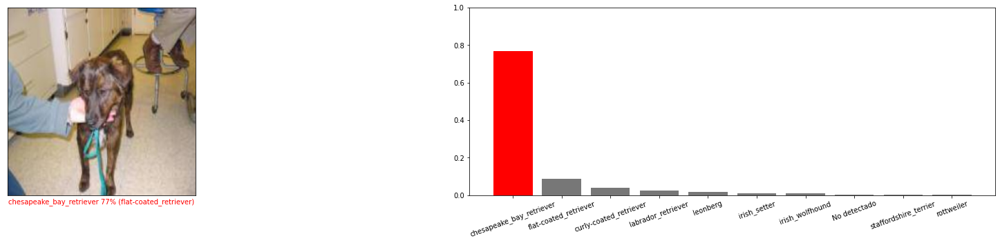

Analizando Raza :  soft-coated_wheaten_terrier
50.442477876106196%
Analizando Raza :  samoyed
51.32743362831859%


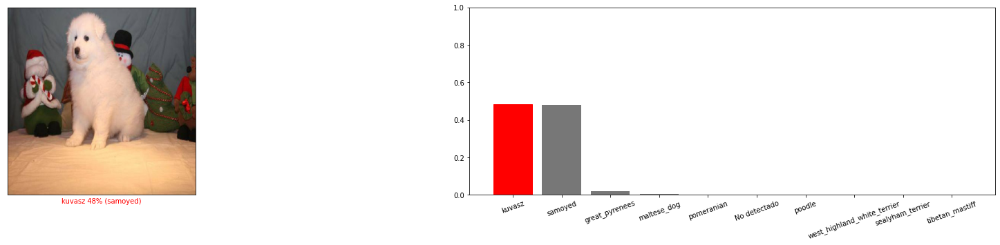

Analizando Raza :  sussex_spaniel
52.21238938053098%
Analizando Raza :  groenendael
53.09734513274337%
Analizando Raza :  appenzeller
53.98230088495575%


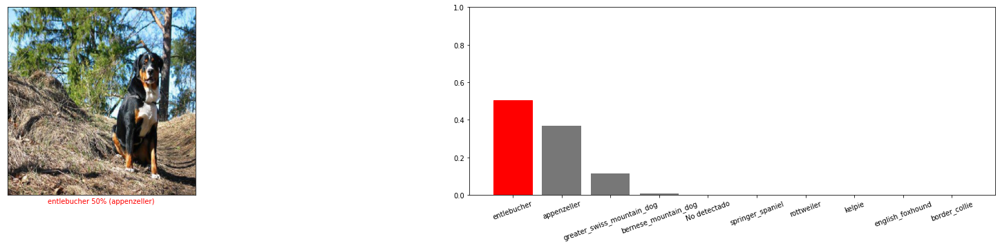

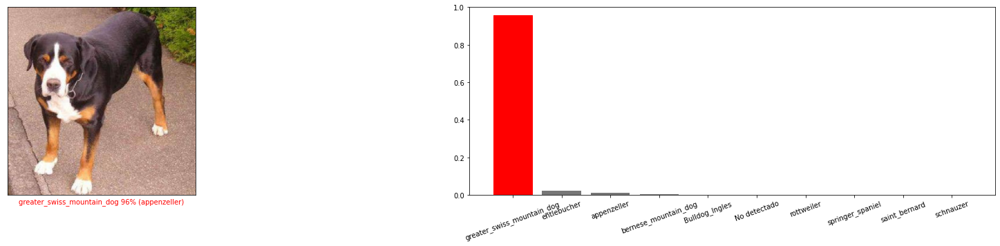

Analizando Raza :  bouvier_des_flandres
54.86725663716814%


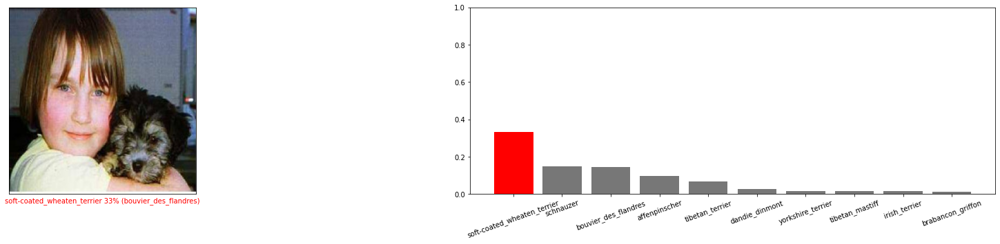

Analizando Raza :  Akita
55.75221238938053%
Analizando Raza :  bedlington_terrier
56.63716814159292%
Analizando Raza :  border_collie
57.52212389380531%
Analizando Raza :  borzoi
58.4070796460177%
Analizando Raza :  border_terrier
59.29203539823009%
Analizando Raza :  saluki
60.17699115044248%
Analizando Raza :  tibetan_terrier
61.06194690265486%


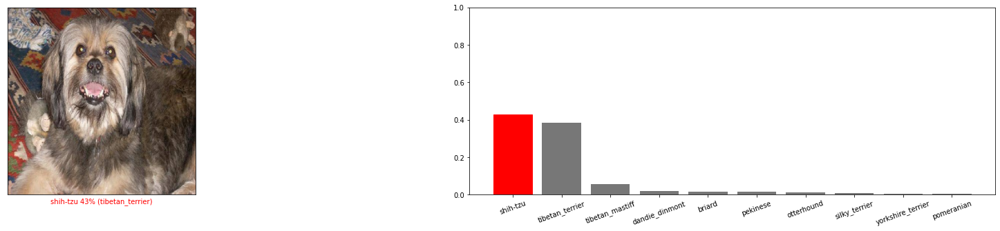

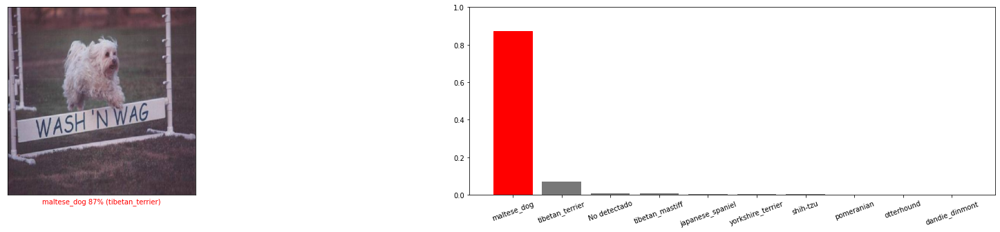

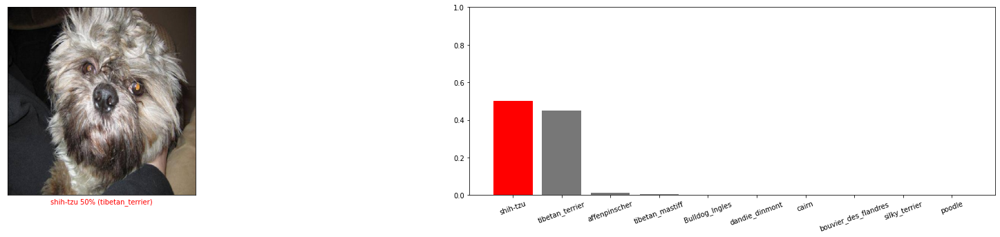

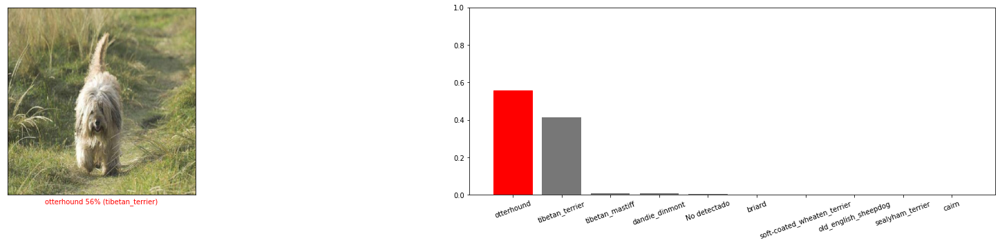

Analizando Raza :  golden_retriever
61.94690265486725%
Analizando Raza :  staffordshire_terrier
62.83185840707964%
Analizando Raza :  otterhound
63.716814159292035%


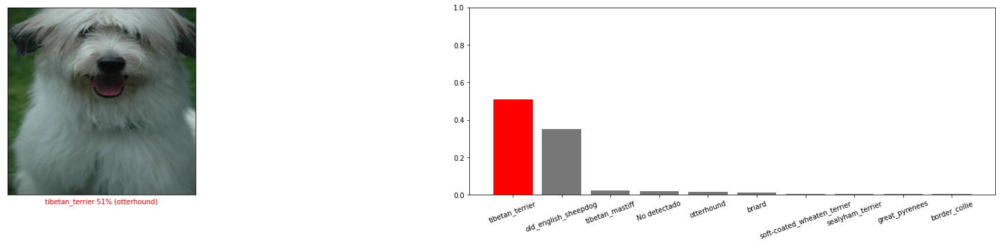

Analizando Raza :  french_bulldog
64.60176991150442%
Analizando Raza :  dingo
65.48672566371681%
Analizando Raza :  poodle
66.3716814159292%


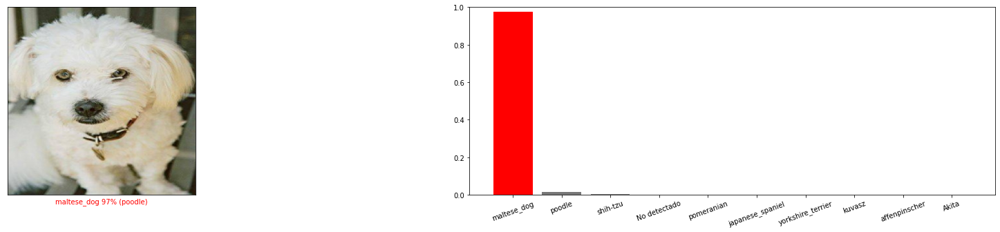

Analizando Raza :  airedale
67.2566371681416%
Analizando Raza :  siberian_husky
68.14159292035397%
Analizando Raza :  keeshond
69.02654867256636%
Analizando Raza :  curly-coated_retriever
69.91150442477876%
Analizando Raza :  chow
70.79646017699115%
Analizando Raza :  bernese_mountain_dog
71.68141592920354%
Analizando Raza :  toy_terrier
72.56637168141593%


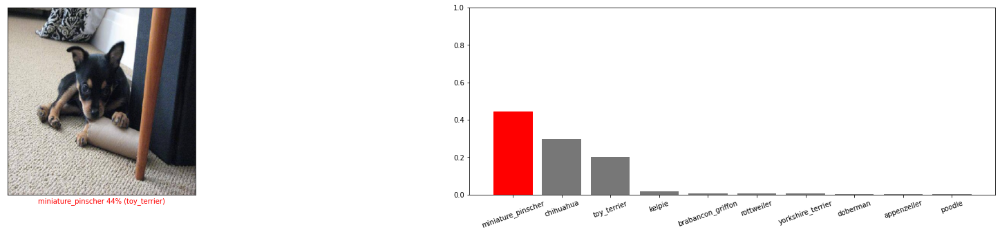

Analizando Raza :  sealyham_terrier
73.45132743362832%
Analizando Raza :  labrador_retriever
74.33628318584071%
Analizando Raza :  kuvasz
75.22123893805309%
Analizando Raza :  briard
76.10619469026548%
Analizando Raza :  german_shepherd
76.99115044247787%
Analizando Raza :  malinois
77.87610619469027%
Analizando Raza :  great_dane
78.76106194690266%
Analizando Raza :  chesapeake_bay_retriever
79.64601769911505%
Analizando Raza :  entlebucher
80.53097345132744%
Analizando Raza :  cardigan
81.41592920353983%
Analizando Raza :  clumber
82.30088495575221%
Analizando Raza :  norfolk_terrier
83.1858407079646%
Analizando Raza :  boxer
84.070796460177%


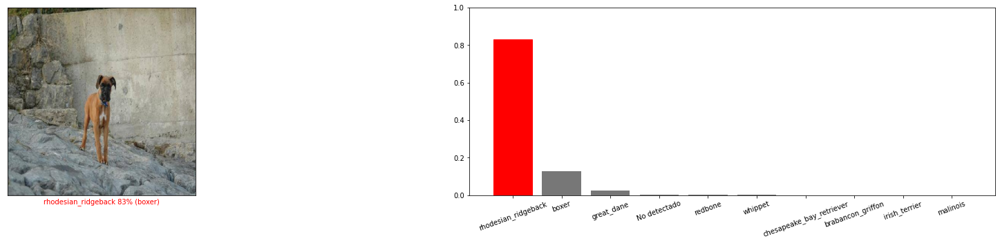

Analizando Raza :  scotch_terrier
84.95575221238938%


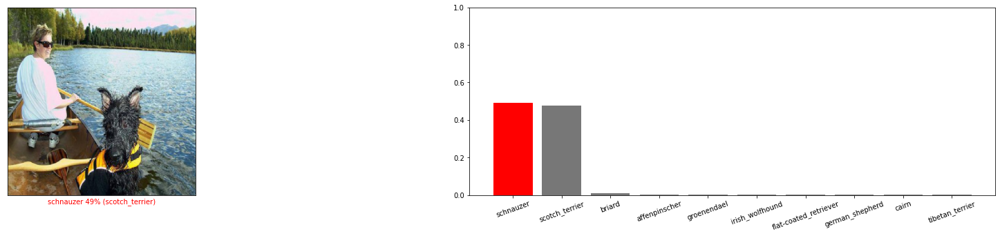

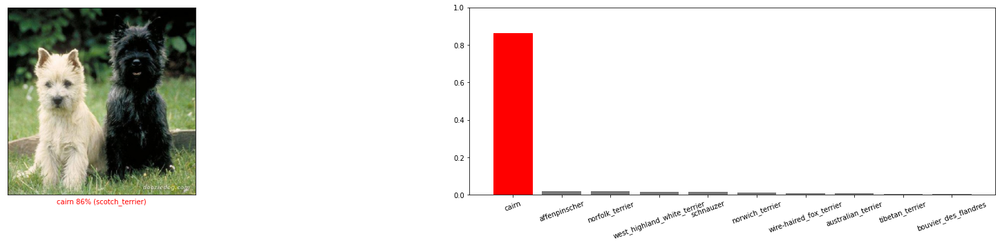

Analizando Raza :  dandie_dinmont
85.84070796460178%
Analizando Raza :  wire-haired_fox_terrier
86.72566371681415%


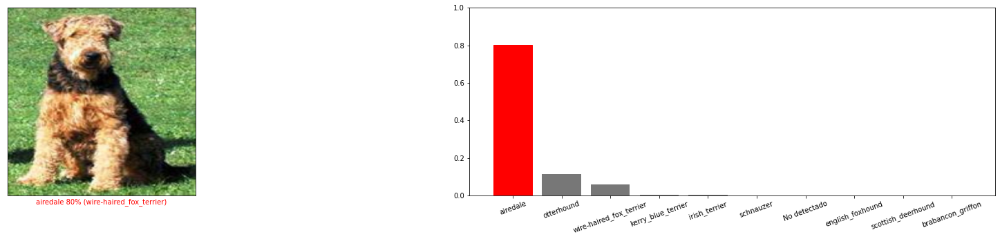

Analizando Raza :  tibetan_mastiff
87.61061946902655%
Analizando Raza :  bull_mastiff
88.49557522123894%


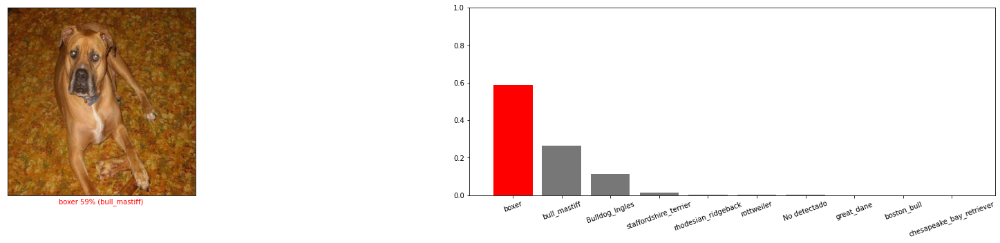

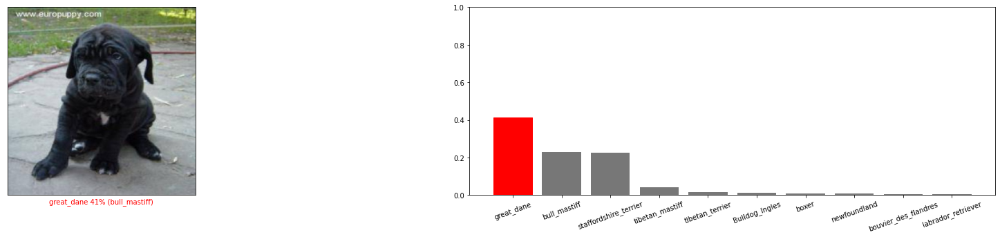

Analizando Raza :  redbone
89.38053097345133%


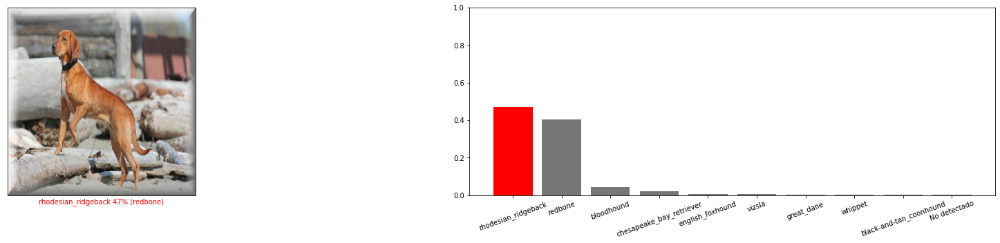

Analizando Raza :  irish_terrier
90.2654867256637%


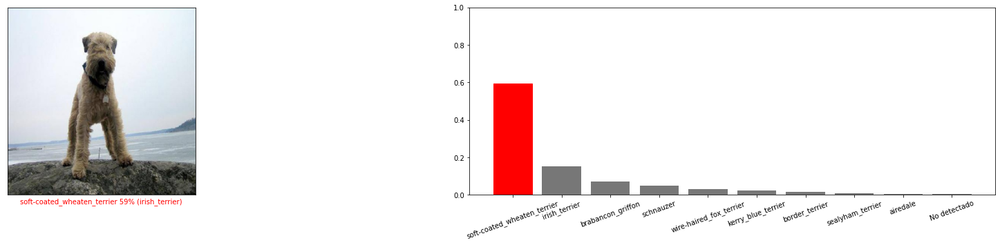

Analizando Raza :  springer_spaniel
91.1504424778761%
Analizando Raza :  irish_water_spaniel
92.03539823008849%


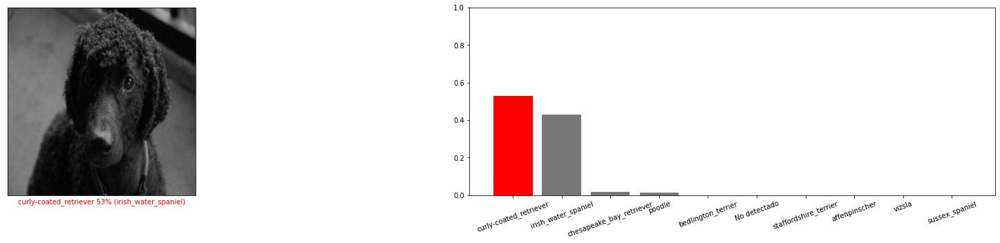

Analizando Raza :  gordon_setter
92.92035398230088%
Analizando Raza :  english_setter
93.80530973451327%


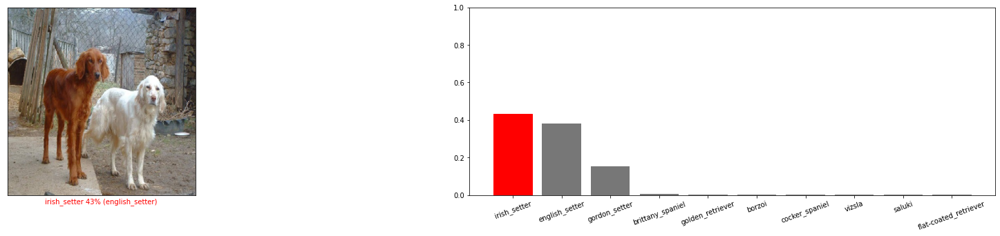

Analizando Raza :  bluetick
94.69026548672566%


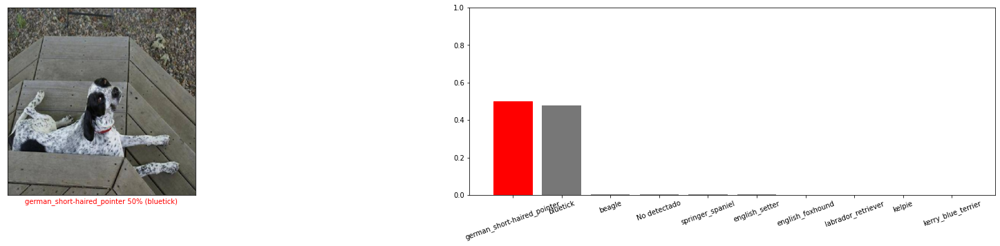

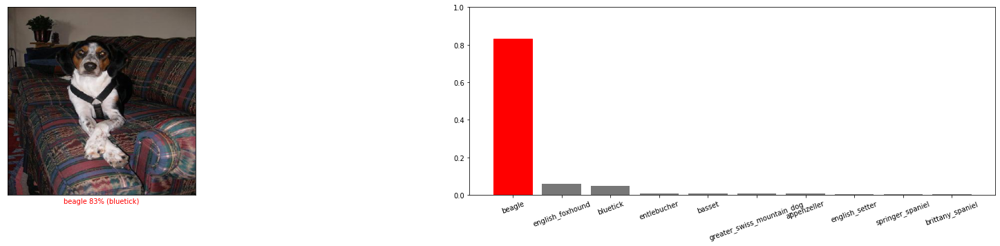

Analizando Raza :  old_english_sheepdog
95.57522123893806%
Analizando Raza :  mexican_hairless
96.46017699115043%
Analizando Raza :  bloodhound
97.34513274336283%
Analizando Raza :  english_foxhound
98.23008849557522%


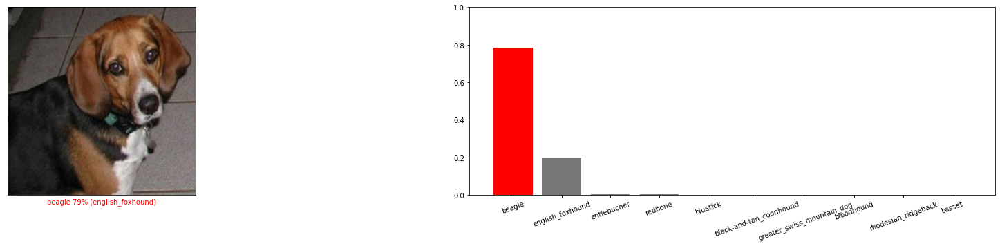

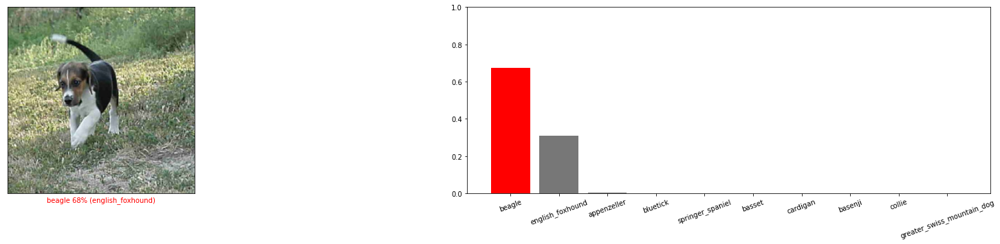

Analizando Raza :  greater_swiss_mountain_dog
99.11504424778761%
Analizando Raza :  german_short-haired_pointer
100.0%


In [ ]:
import os 
error_breeds = []
count = 1
for breed in os.listdir(test_dir):
  if breed == '.DS_Store':
    continue
  print("Analizando Raza : ", breed)
  print(f"{count/113*100}%")
  for dog in os.listdir(os.path.join(test_dir, breed)):
    if dog == '.DS_Store':
      continue
    img_path = os.path.join(test_dir,breed,dog)
    error_breed = plot_wrong_predictions(model, img_path, breed , class_names = test_data.class_names)
    error_breeds.append(error_breed)
  count += 1

In [ ]:
from collections import Counter
count_test_errors = Counter(error_breeds)
count_test_errors

Counter({None: 1951,
         'appenzeller': 2,
         'australian_terrier': 1,
         'beagle': 2,
         'blenheim_spaniel': 1,
         'bluetick': 2,
         'boston_bull': 1,
         'bouvier_des_flandres': 1,
         'boxer': 1,
         'bull_mastiff': 2,
         'chihuahua': 1,
         'english_foxhound': 2,
         'english_setter': 1,
         'flat-coated_retriever': 1,
         'irish_terrier': 1,
         'irish_water_spaniel': 1,
         'kelpie': 1,
         'komondor': 1,
         'maltese_dog': 1,
         'norwegian_elkhound': 1,
         'otterhound': 1,
         'poodle': 1,
         'redbone': 1,
         'rottweiler': 1,
         'samoyed': 1,
         'schipperke': 1,
         'scotch_terrier': 2,
         'silky_terrier': 4,
         'tibetan_terrier': 4,
         'toy_terrier': 1,
         'vizsla': 1,
         'west_highland_white_terrier': 1,
         'whippet': 1,
         'wire-haired_fox_terrier': 1,
         'yorkshire_terrier': 1})

1

## Train

Analizando Raza :  whippet
0.8%
Analizando Raza :  maltese_dog
1.6%
Analizando Raza :  Bulldog_Ingles
2.4%


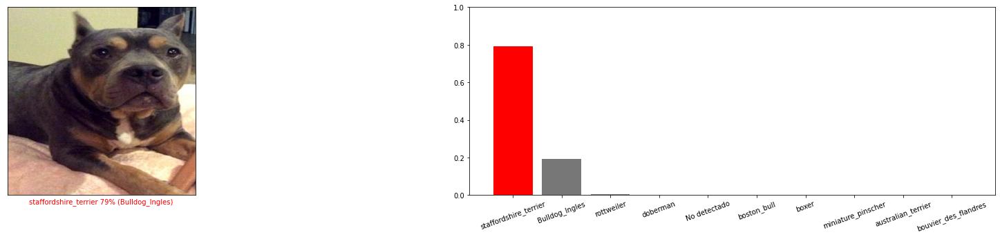

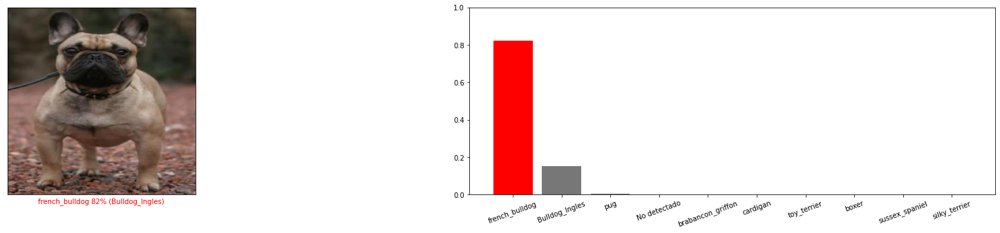

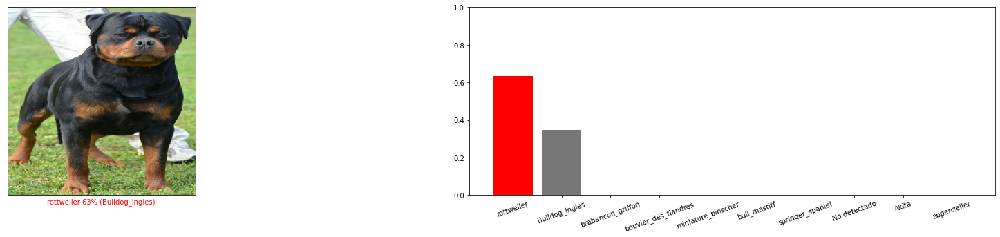

Analizando Raza :  great_pyrenees
3.2%


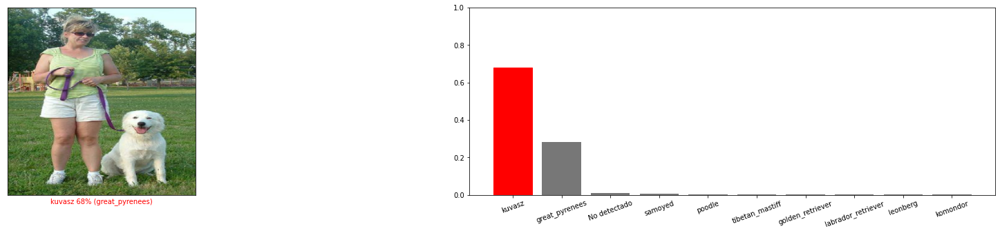

Analizando Raza :  norwich_terrier
4.0%


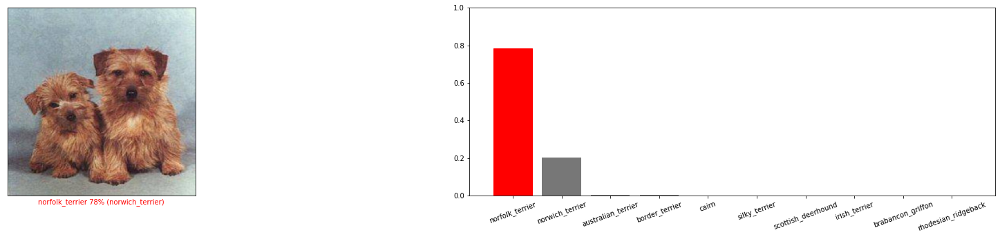

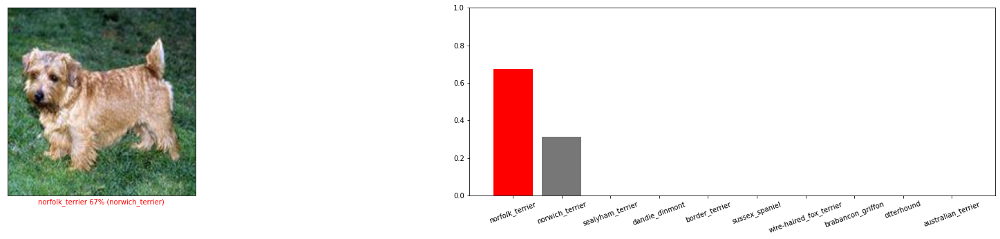

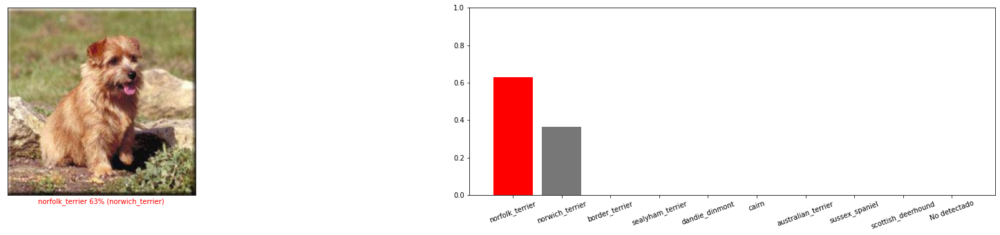

Analizando Raza :  australian_terrier
4.8%


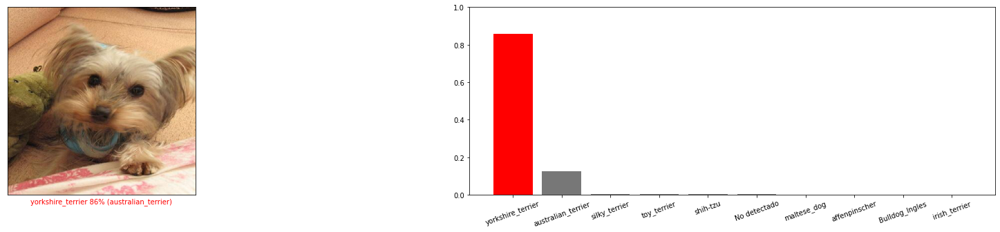

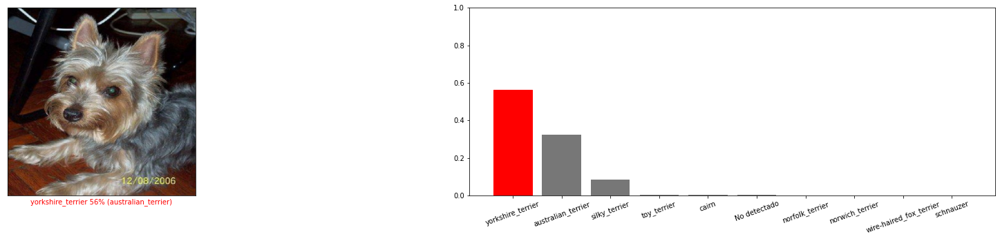

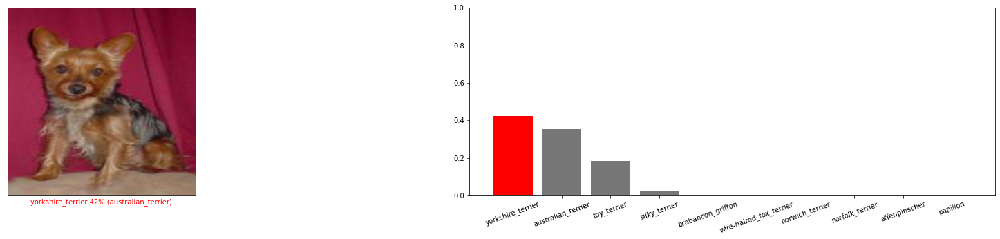

Analizando Raza :  irish_setter
5.6000000000000005%
Analizando Raza :  rottweiler
6.4%
Analizando Raza :  kelpie
7.199999999999999%
Analizando Raza :  boston_bull
8.0%
Analizando Raza :  Dalmata
8.799999999999999%
Analizando Raza :  schnauzer
9.6%


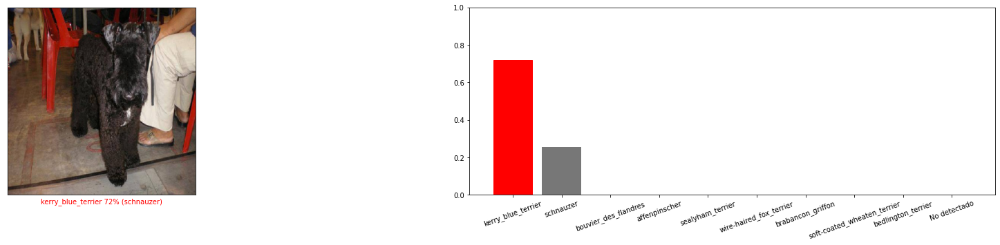

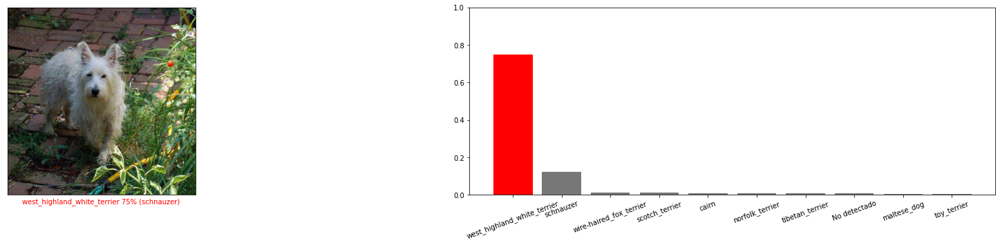

Analizando Raza :  leonberg
10.4%
Analizando Raza :  pekinese
11.200000000000001%
Analizando Raza :  pomeranian
12.0%
Analizando Raza :  schipperke
12.8%
Analizando Raza :  blenheim_spaniel
13.600000000000001%
Analizando Raza :  basenji
14.399999999999999%
Analizando Raza :  irish_wolfhound
15.2%


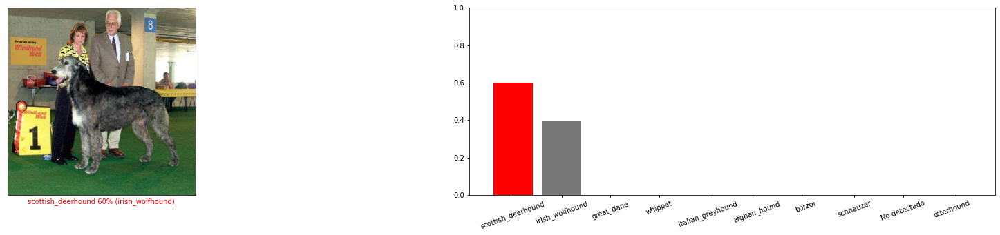

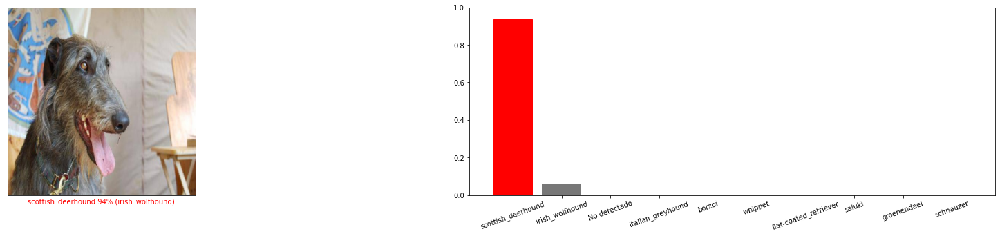

Analizando Raza :  No detectado
16.0%
Analizando Raza :  basset
16.8%
Analizando Raza :  yorkshire_terrier
17.599999999999998%
Analizando Raza :  gato
18.4%
Analizando Raza :  african_hunting_dog
19.2%
Analizando Raza :  japanese_spaniel
20.0%


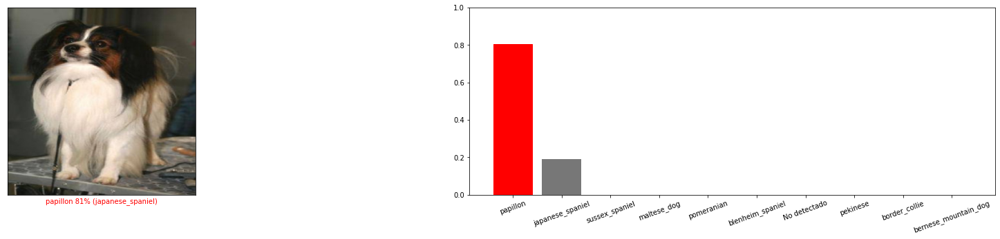

Analizando Raza :  komondor
20.8%
Analizando Raza :  dhole
21.6%
Analizando Raza :  miniature_pinscher
22.400000000000002%
Analizando Raza :  kerry_blue_terrier
23.200000000000003%
Analizando Raza :  saint_bernard
24.0%
Analizando Raza :  black-and-tan_coonhound
24.8%
Analizando Raza :  afghan_hound
25.6%
Analizando Raza :  scottish_deerhound
26.400000000000002%


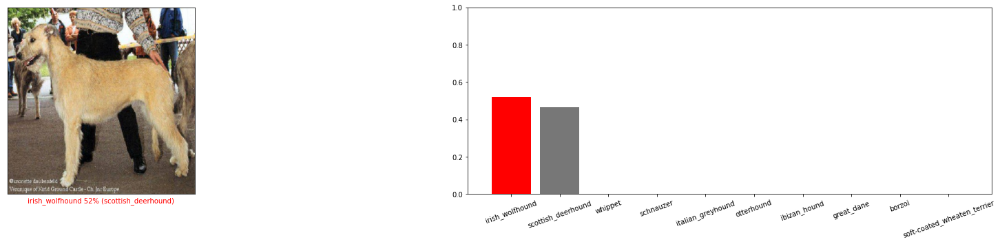

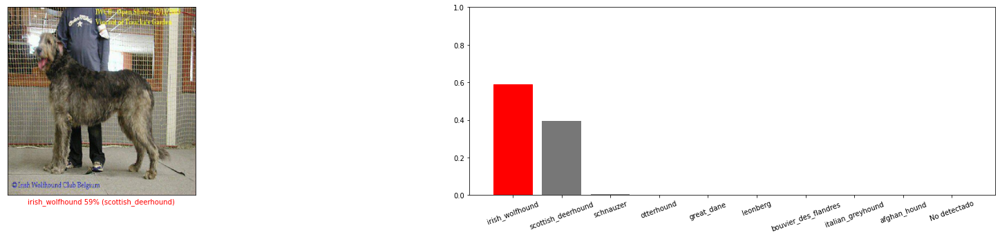

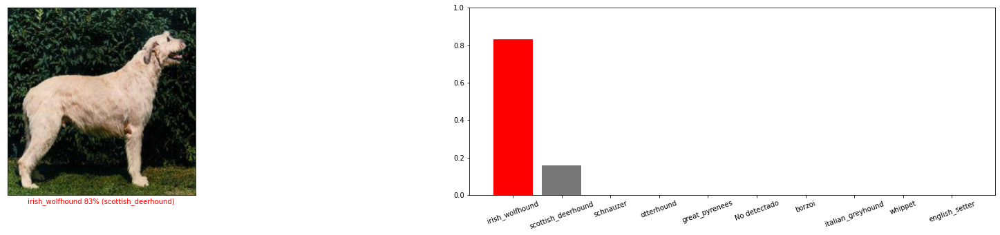

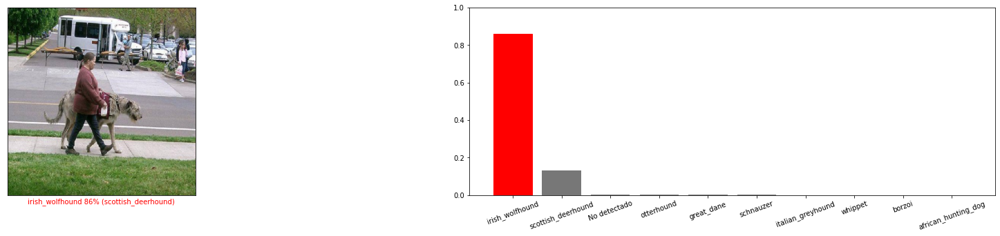

Analizando Raza :  chihuahua
27.200000000000003%
Analizando Raza :  newfoundland
28.000000000000004%
Analizando Raza :  pug
28.799999999999997%


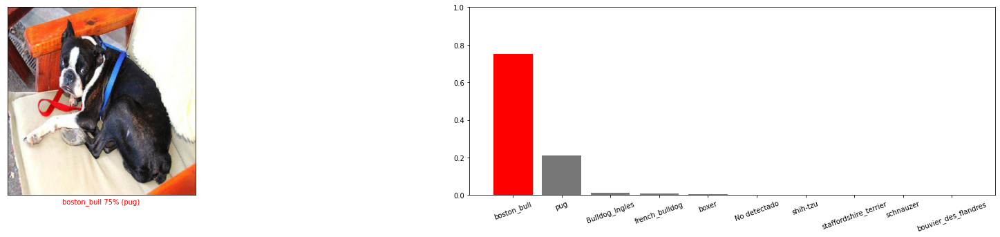

Analizando Raza :  cairn
29.599999999999998%


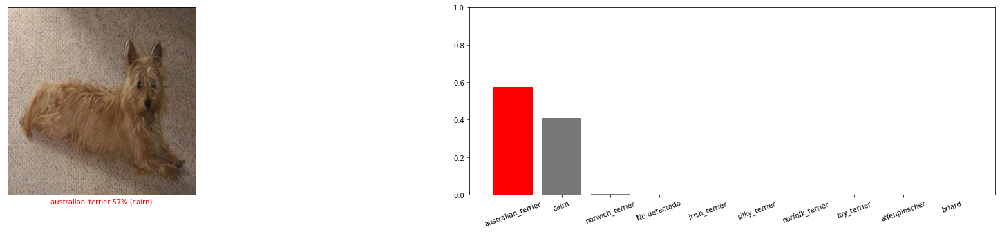

Analizando Raza :  vizsla
30.4%
Analizando Raza :  collie
31.2%


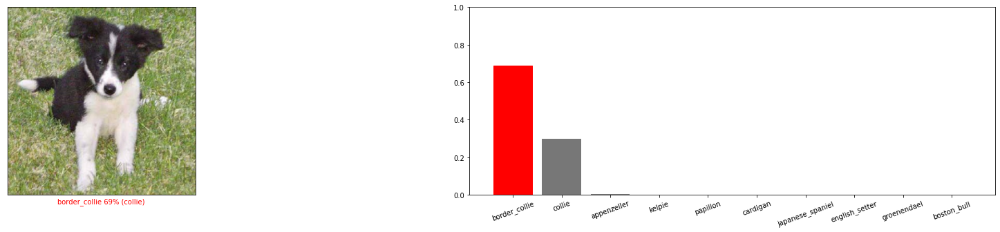

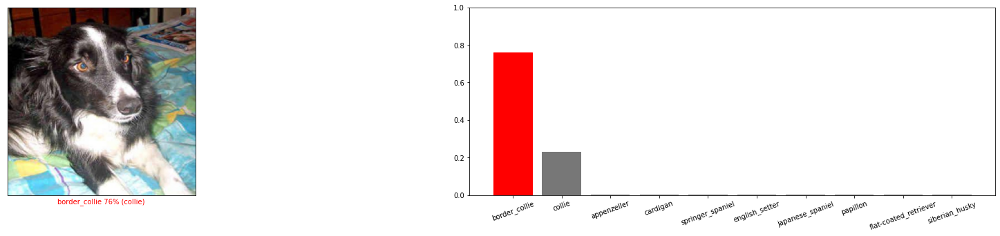

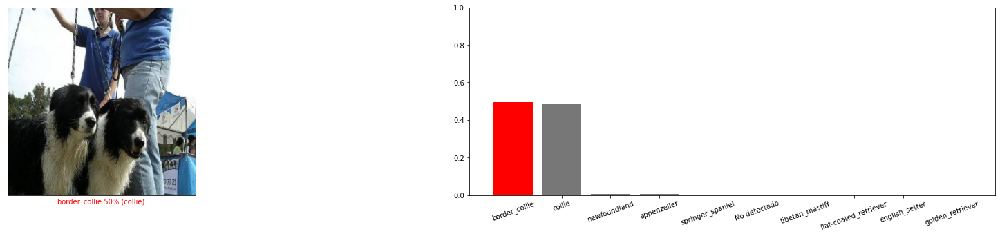

Analizando Raza :  beagle
32.0%


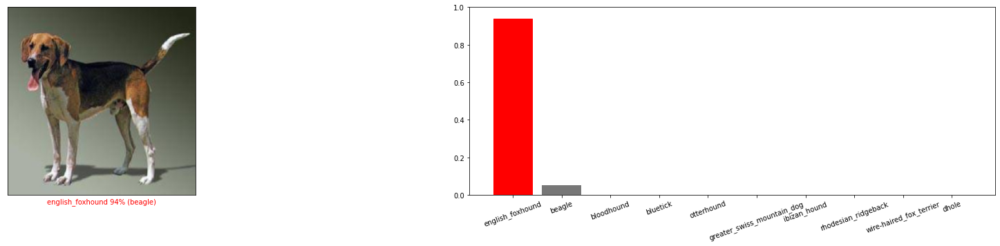

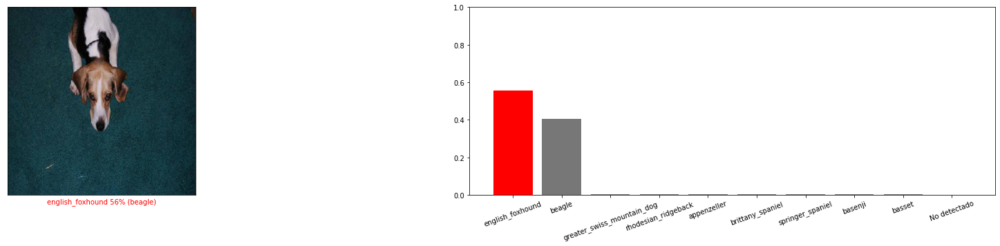

Analizando Raza :  brittany_spaniel
32.800000000000004%
Analizando Raza :  doberman
33.6%


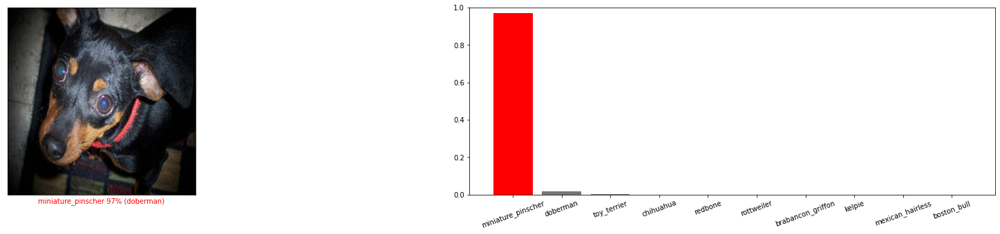

Analizando Raza :  silky_terrier
34.4%


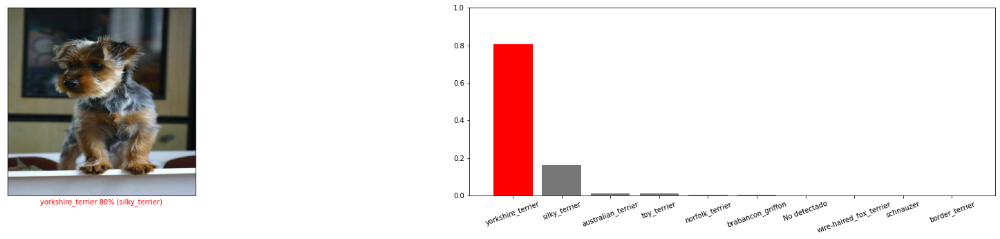

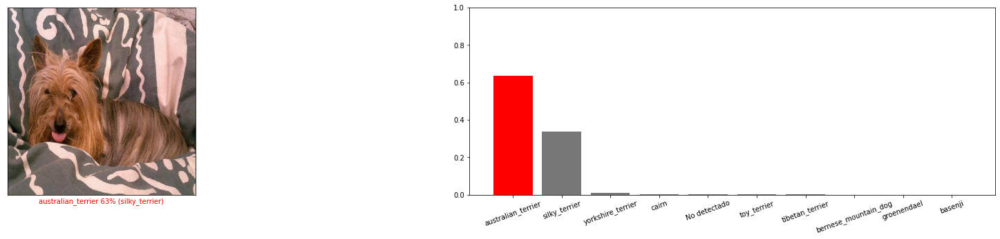

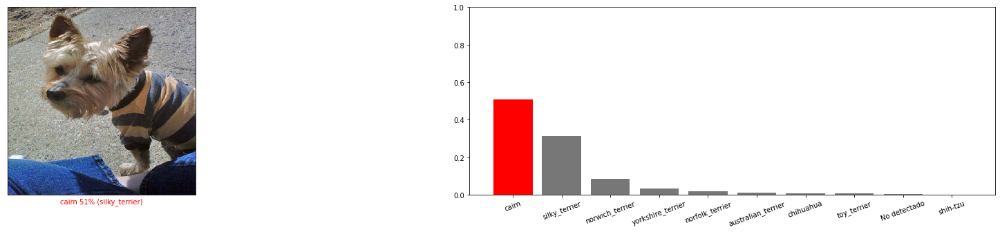

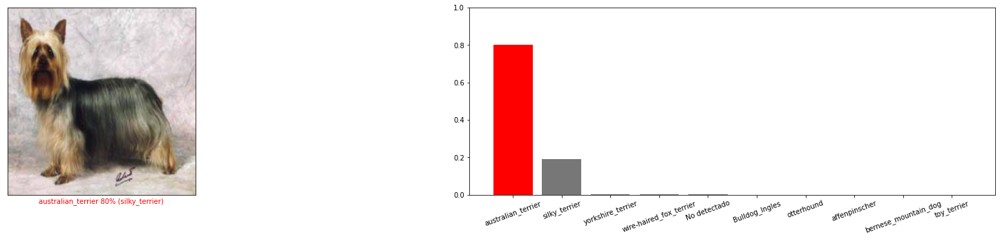

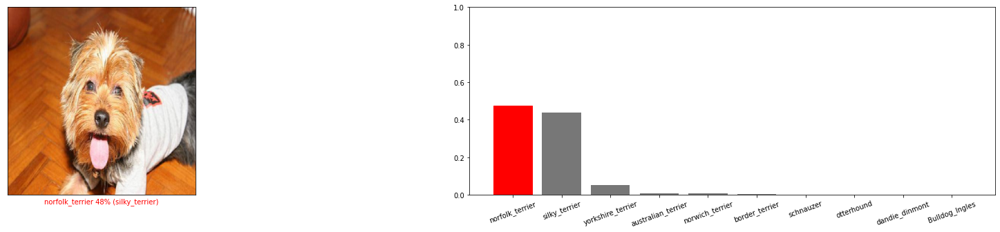

Analizando Raza :  west_highland_white_terrier
35.199999999999996%
Analizando Raza :  affenpinscher
36.0%
Analizando Raza :  italian_greyhound
36.8%
Analizando Raza :  papillon
37.6%
Analizando Raza :  pembroke
38.4%
Analizando Raza :  norwegian_elkhound
39.2%


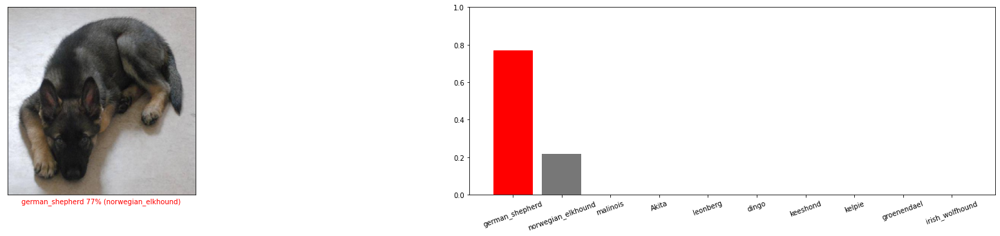

Analizando Raza :  weimaraner
40.0%


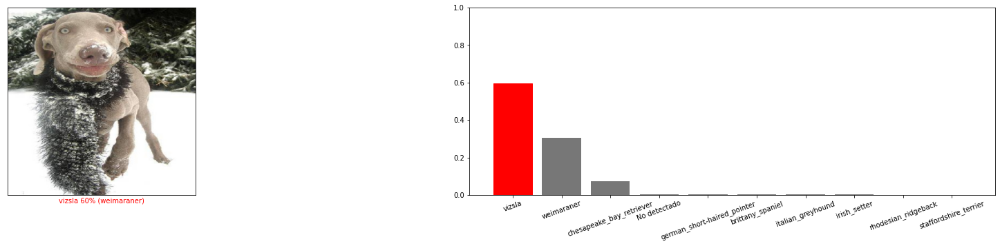

Analizando Raza :  soft-coated_wheaten_terrier
40.8%
Analizando Raza :  sussex_spaniel
41.6%
Analizando Raza :  ibizan_hound
42.4%


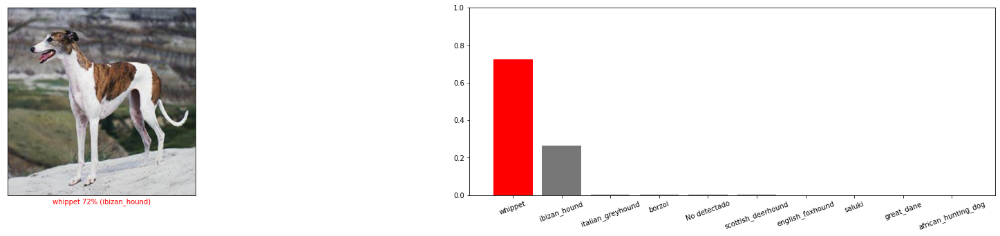

Analizando Raza :  shih-tzu
43.2%
Analizando Raza :  brabancon_griffon
44.0%
Analizando Raza :  flat-coated_retriever
44.800000000000004%


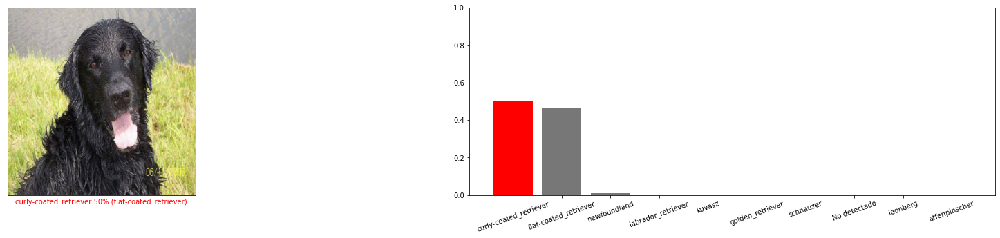

Analizando Raza :  groenendael
45.6%
Analizando Raza :  cocker_spaniel
46.400000000000006%
Analizando Raza :  rhodesian_ridgeback
47.199999999999996%
Analizando Raza :  samoyed
48.0%
Analizando Raza :  tibetan_terrier
48.8%


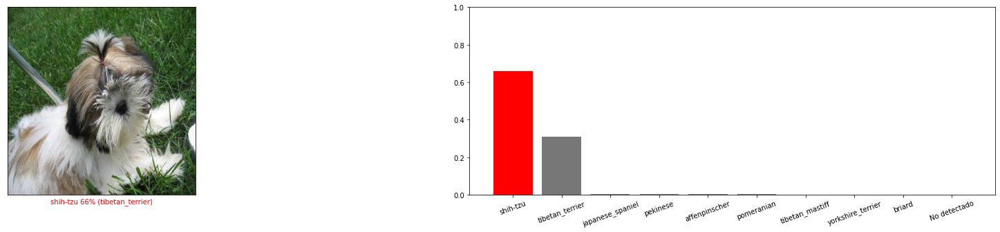

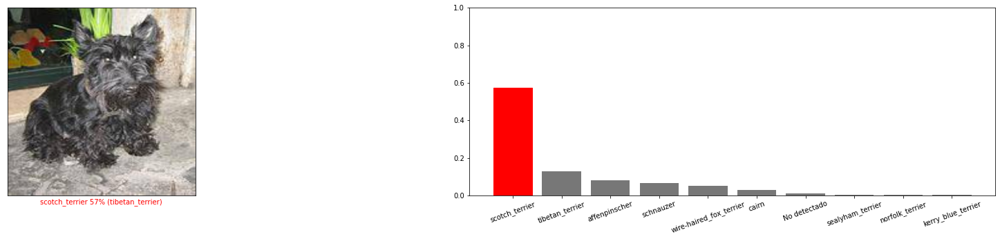

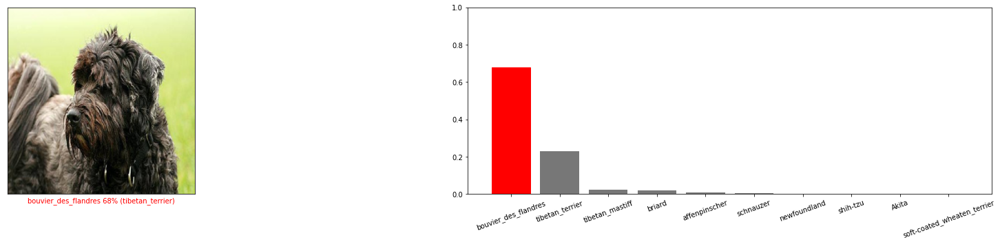

Analizando Raza :  golden_retriever
49.6%
Analizando Raza :  saluki
50.4%
Analizando Raza :  bouvier_des_flandres
51.2%


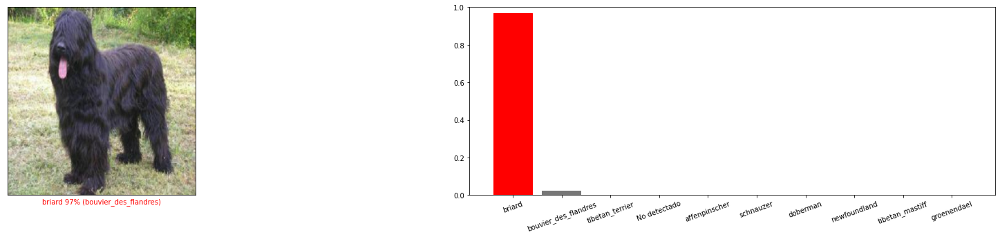

Analizando Raza :  border_collie
52.0%
Analizando Raza :  appenzeller
52.800000000000004%
Analizando Raza :  Akita
53.6%
Analizando Raza :  border_terrier
54.400000000000006%
Analizando Raza :  bedlington_terrier
55.2%
Analizando Raza :  borzoi
56.00000000000001%
Analizando Raza :  siberian_husky
56.8%
Analizando Raza :  curly-coated_retriever
57.599999999999994%


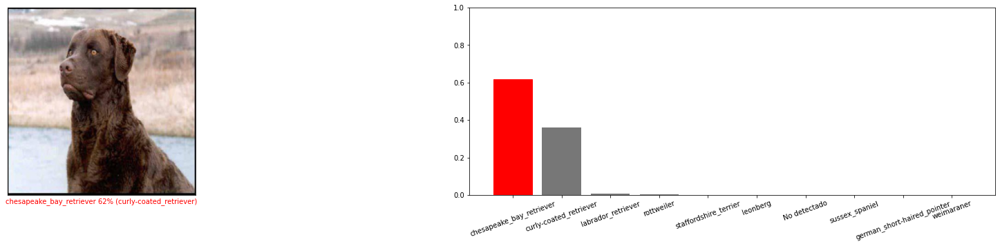

Analizando Raza :  staffordshire_terrier
58.4%
Analizando Raza :  chow
59.199999999999996%
Analizando Raza :  poodle
60.0%
Analizando Raza :  airedale
60.8%
Analizando Raza :  otterhound
61.6%


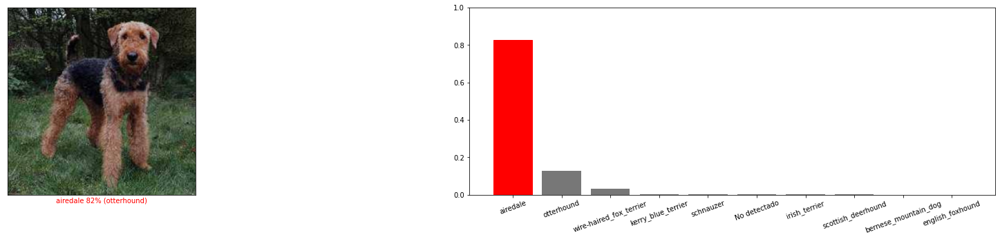

Analizando Raza :  dingo
62.4%
Analizando Raza :  keeshond
63.2%
Analizando Raza :  toy_terrier
64.0%
Analizando Raza :  french_bulldog
64.8%
Analizando Raza :  labrador_retriever
65.60000000000001%
Analizando Raza :  sealyham_terrier
66.4%


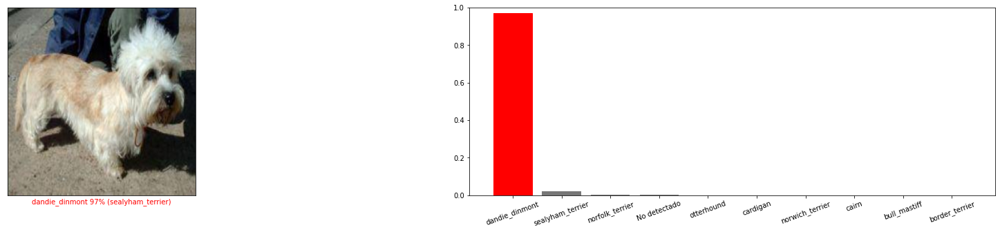

Analizando Raza :  bernese_mountain_dog
67.2%


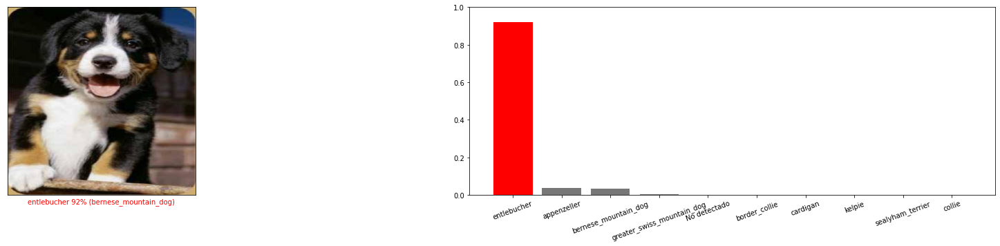

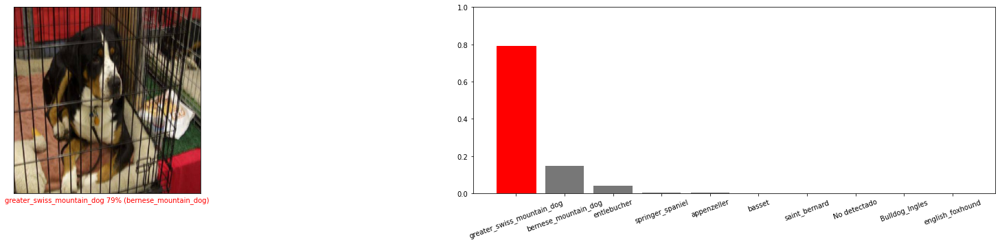

Analizando Raza :  kuvasz
68.0%
Analizando Raza :  chesapeake_bay_retriever
68.8%
Analizando Raza :  briard
69.6%
Analizando Raza :  german_shepherd
70.39999999999999%


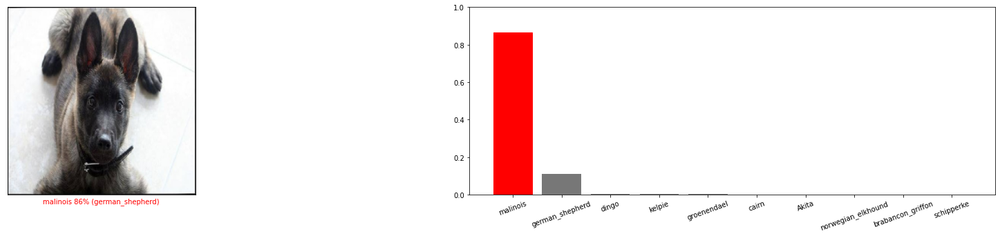

Analizando Raza :  norfolk_terrier
71.2%


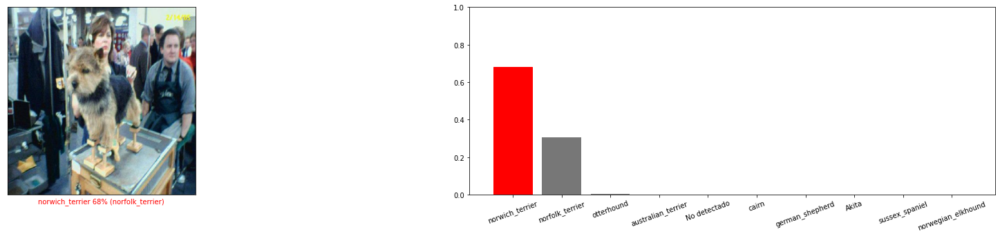

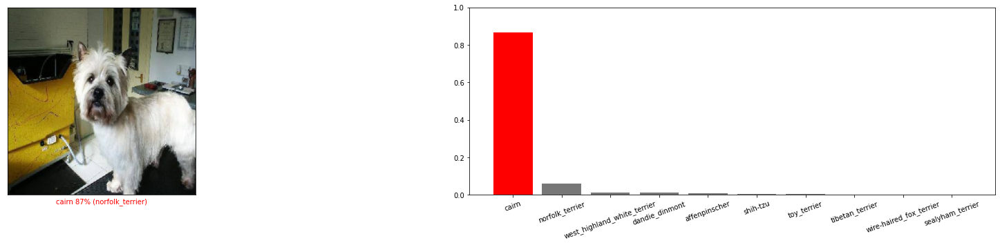

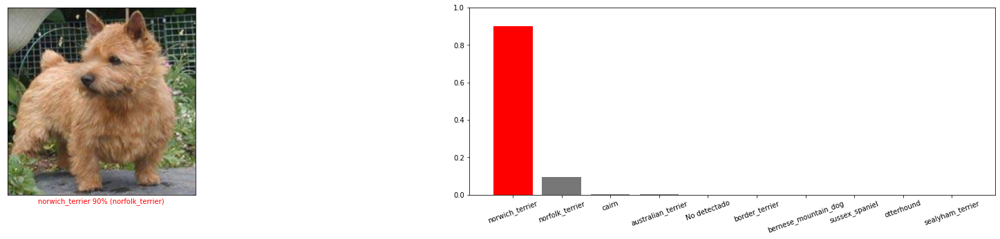

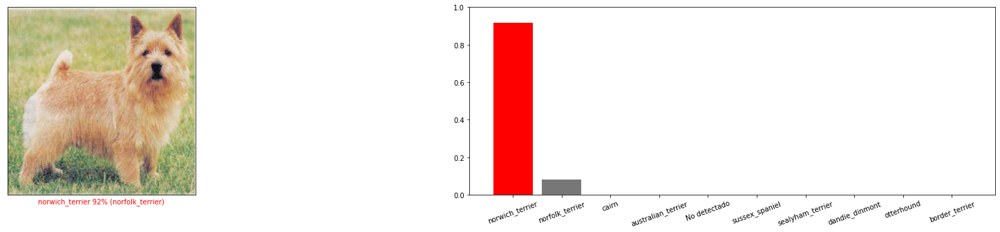

Analizando Raza :  bull_mastiff
72.0%
Analizando Raza :  great_dane
72.8%
Analizando Raza :  wire-haired_fox_terrier
73.6%


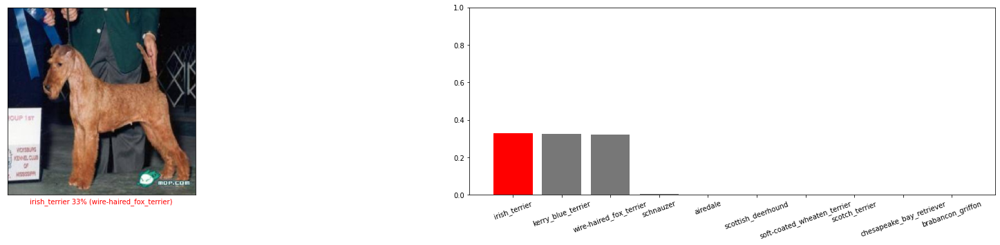

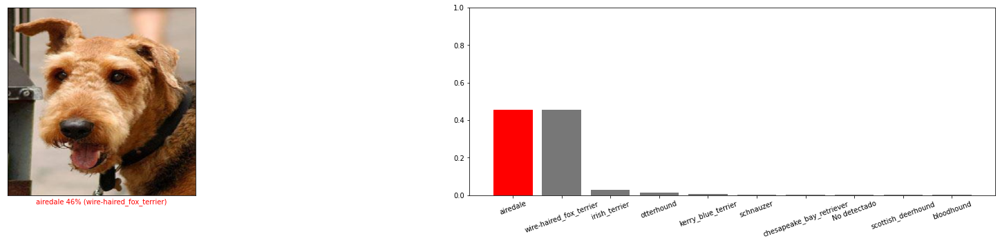

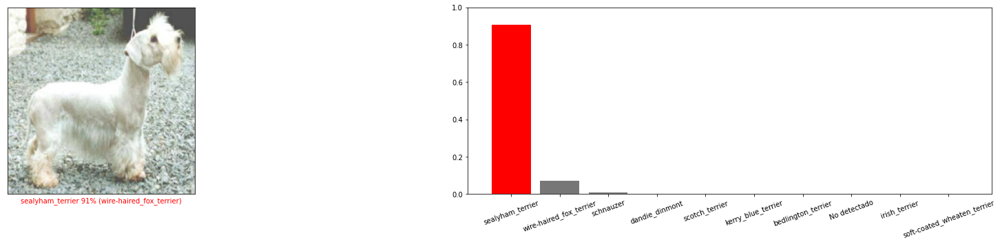

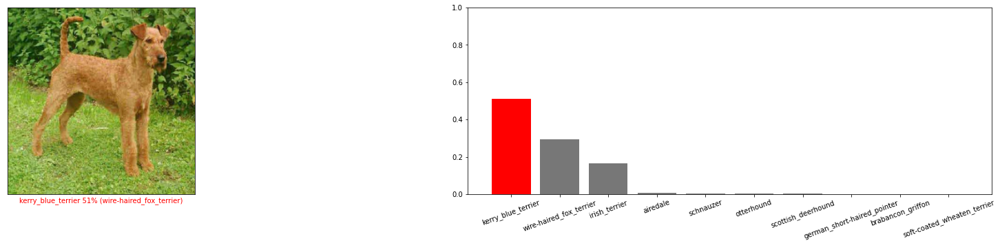

Analizando Raza :  dandie_dinmont
74.4%
Analizando Raza :  malinois
75.2%
Analizando Raza :  scotch_terrier
76.0%
Analizando Raza :  clumber
76.8%
Analizando Raza :  boxer
77.60000000000001%


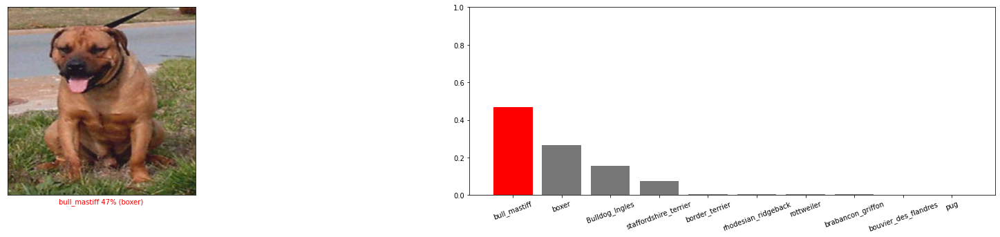

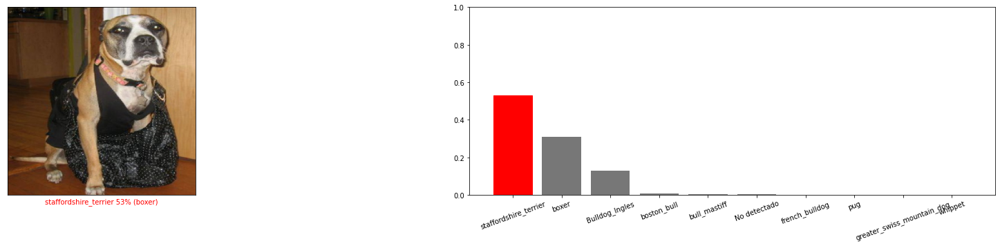

Analizando Raza :  entlebucher
78.4%


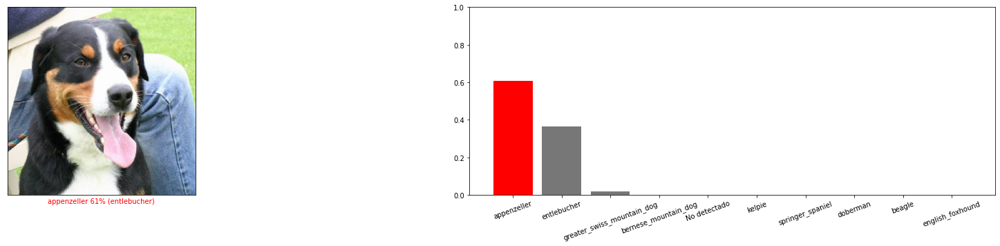

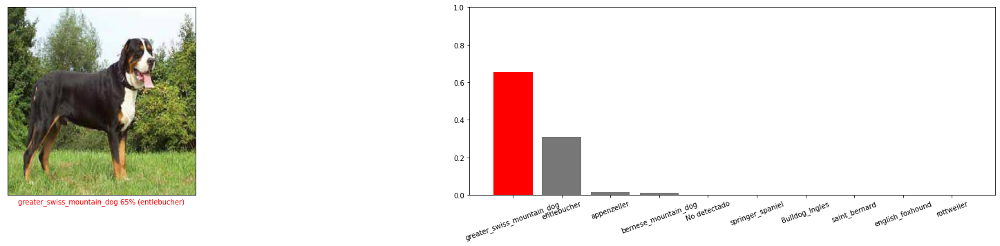

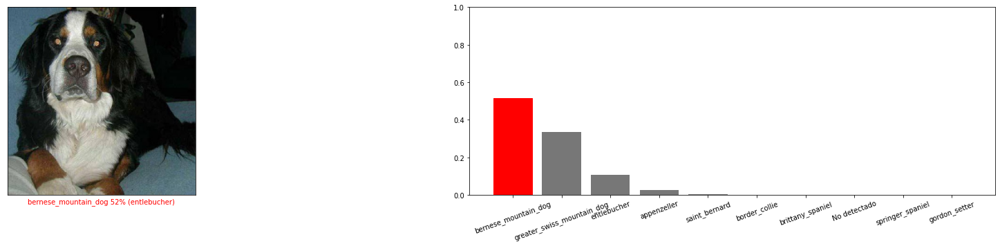

Analizando Raza :  bloodhound
79.2%
Analizando Raza :  tibetan_mastiff
80.0%
Analizando Raza :  bluetick
80.80000000000001%


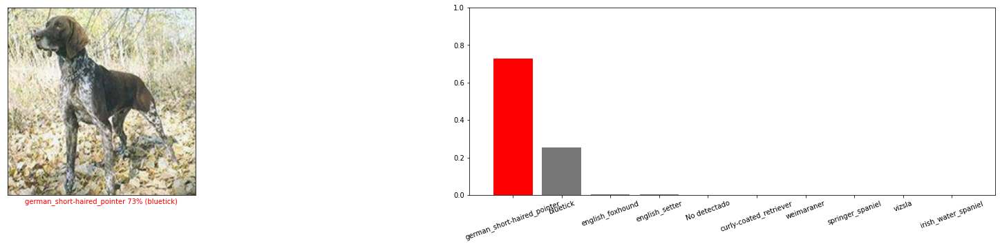

Analizando Raza :  cardigan
81.6%
Analizando Raza :  old_english_sheepdog
82.39999999999999%
Analizando Raza :  irish_water_spaniel
83.2%
Analizando Raza :  english_setter
84.0%
Analizando Raza :  irish_terrier
84.8%
Analizando Raza :  mexican_hairless
85.6%


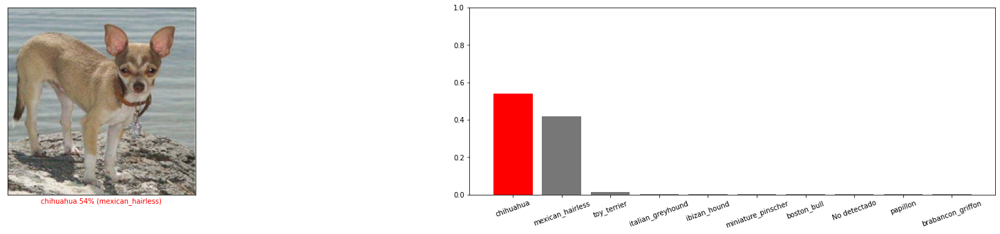

Analizando Raza :  springer_spaniel
86.4%
Analizando Raza :  gordon_setter
87.2%


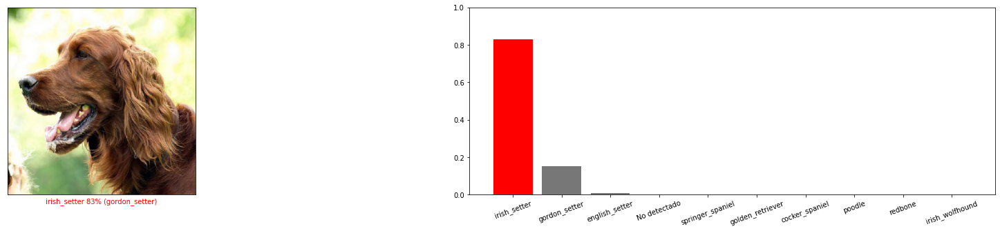

Analizando Raza :  german_short-haired_pointer
88.0%
Analizando Raza :  english_foxhound
88.8%


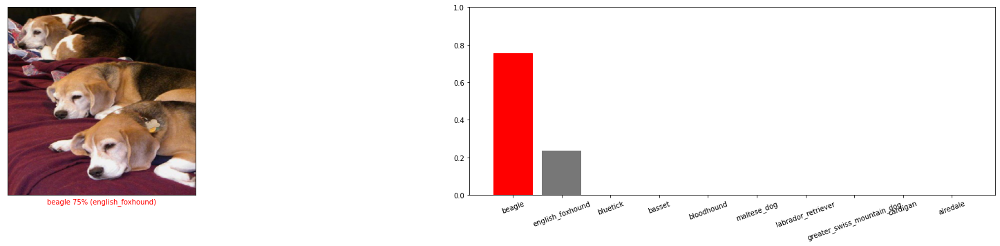

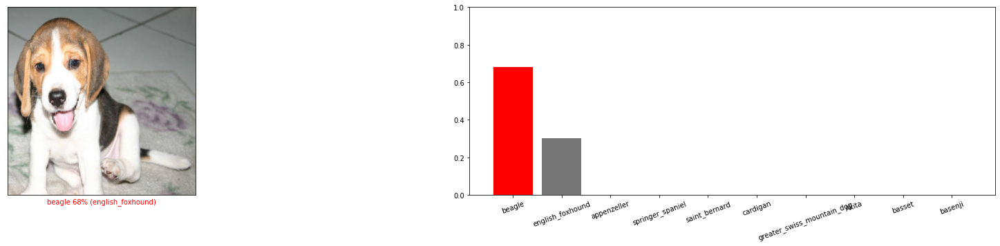

Analizando Raza :  greater_swiss_mountain_dog
89.60000000000001%


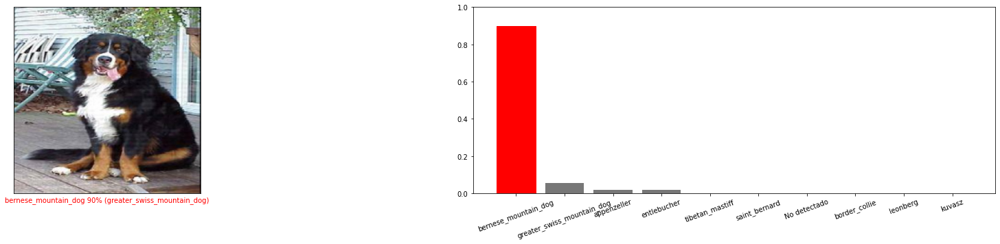

Analizando Raza :  redbone
90.4%


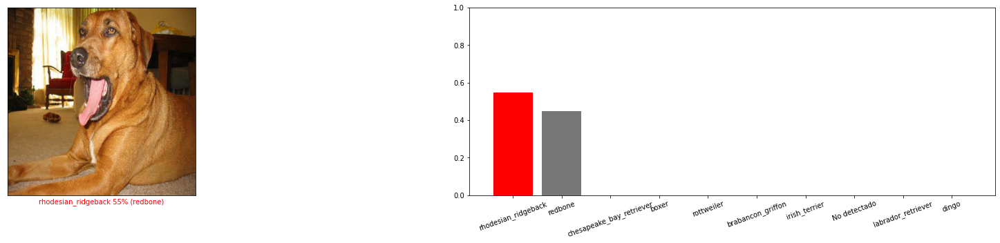

In [ ]:
import os 
error_breeds = []
count = 1
for breed in os.listdir(train_dir):
  if breed == '.DS_Store':
    continue
  print("Analizando Raza : ", breed)
  print(f"{count/125*100}%")
  for dog in os.listdir(os.path.join(train_dir, breed)):
    if dog == '.DS_Store':
      continue
    img_path = os.path.join(train_dir,breed,dog)
    error_breed = plot_wrong_predictions(model, img_path, breed , class_names = train_data.class_names)
    error_breeds.append(error_breed)
  count += 1

In [ ]:
from collections import Counter
cont_train_errors = Counter(error_breeds)
cont_train_errors

Counter({'Bulldog_Ingles': 3,
         None: 8111,
         'australian_terrier': 3,
         'beagle': 2,
         'bernese_mountain_dog': 2,
         'bluetick': 1,
         'bouvier_des_flandres': 1,
         'boxer': 2,
         'cairn': 1,
         'collie': 3,
         'curly-coated_retriever': 1,
         'doberman': 1,
         'english_foxhound': 2,
         'entlebucher': 3,
         'flat-coated_retriever': 1,
         'german_shepherd': 1,
         'gordon_setter': 1,
         'great_pyrenees': 1,
         'greater_swiss_mountain_dog': 1,
         'ibizan_hound': 1,
         'irish_wolfhound': 2,
         'japanese_spaniel': 1,
         'mexican_hairless': 1,
         'norfolk_terrier': 4,
         'norwegian_elkhound': 1,
         'norwich_terrier': 3,
         'otterhound': 1,
         'pug': 1,
         'redbone': 1,
         'schnauzer': 2,
         'scottish_deerhound': 4,
         'sealyham_terrier': 1,
         'silky_terrier': 5,
         'tibetan_terrier': 3,
     

# Cuantificación del modelo
A la hora de desplegar el modelo, tuve errores por el peso de mis archivos, específicamente el modelo, por lo que intentaré reducir su peso cuantificando mi modelo:
https://www.tensorflow.org/lite/performance/post_training_quantization

Especificamente utilizaré la cuantificación de rango dinámico:
- Cuantización de rango dinámico


In [ ]:
model_path = '/content/drive/MyDrive/Colab Data/Proyecto buscomiperro/modelos/model_v3-Finetune.h5'
model = load_model(model_path)

Primero hay que guardar el modelo

In [ ]:
saver = tf.train.Saver()
save_path = saver.save(sess, model_path)

In [ ]:
converter = tf.lite.TFLiteConverter.from_keras_model(model)
converter.optimizations = [tf.lite.Optimize.DEFAULT]
tflite_quant_model = converter.convert()

/usr/local/lib/python3.7/dist-packages/tensorflow/python/keras/utils/generic_utils.py:497: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  category=CustomMaskWarning)


INFO:tensorflow:Assets written to: /tmp/tmp3451bonj/assets


INFO:tensorflow:Assets written to: /tmp/tmp3451bonj/assets


In [ ]:
with open('model.tflite', 'wb') as f:
  f.write(tflite_quant_model)

In [ ]:
interpreter = tf.lite.Interpreter('/content/model.tflite')

In [ ]:
input_details = interpreter.get_input_details()
output_details = interpreter.get_output_details()
interpreter.allocate_tensors()

In [ ]:
from keras.preprocessing.image import load_img
from keras.preprocessing.image import img_to_array
img = load_img('d.jpeg', target_size = (600,600))

In [ ]:
x = tf.expand_dims(img_to_array(img), axis = 0)

In [ ]:
interpreter.set_tensor(input_details[0]['index'], x)

In [ ]:
interpreter.invoke()

In [ ]:
output_data = interpreter.get_tensor(output_details[0]['index'])